GRRIVE_PATH에 2개의모델 파일과 데이터 파일을 가져다 놓는다.

# 설정

In [4]:
HOME = "/content"

In [5]:
GDRIVE_PATH = "/gdrive/MyDrive/tmp/face"
FACE_DETECTION_MODEL_FILE = "face_detection.weights"
FACE_CLASSIFICATION_MODEL_FILE = "face_classification.h5"
DATA_FILE_NAME = "face.zip"
class_names = [ "Tom", "Jerry" ]

In [6]:
TARGET_PATH = "face/train"
CROPPED_PATH = TARGET_PATH+"/cropped"

# 드라이브 연결

In [7]:
from google.colab import drive
drive.mount('/gdrive')

Mounted at /gdrive


# 가짜 데이터 만들기

In [14]:
!rm -rf /gdirve/MyDrive/tmp/face
!mkdir -p /gdirve/MyDrive/tmp/face
!cp /gdrive/MyDrive/tmp/Raccoon.zip /gdrive/MyDrive/tmp/face/face.zip
!cp /gdrive/MyDrive/tmp/yolov3_custom_last.weights /gdrive/MyDrive/tmp/face/face_detection.weights
!cp /gdrive/MyDrive/tmp/model.h5 /gdrive/MyDrive/tmp/face/face_classification.h5

# 얼굴 탐지 학습

In [8]:
import cv2
import matplotlib.pyplot as plt
import glob

## 프로젝트 다운로드

In [9]:
!git clone https://github.com/AlexeyAB/darknet.git

Cloning into 'darknet'...
remote: Enumerating objects: 15395, done.
remote: Total 15395 (delta 0), reused 0 (delta 0), pack-reused 15395
Receiving objects: 100% (15395/15395), 13.99 MiB | 27.08 MiB/s, done.
Resolving deltas: 100% (10354/10354), done.


OpenCV, GPU, CuDNN 사용 관련 설정하고 컴파일

In [10]:
%cd darknet

/content/darknet


## 컴파일 설정 파일 수정

In [11]:
!sed -i 's/OPENCV=0/OPENCV=1/' Makefile
!sed -i 's/GPU=0/GPU=1/' Makefile
!sed -i 's/CUDNN=0/CUDNN=1/' Makefile

## 컴파일

In [12]:
!make

mkdir -p ./obj/
mkdir -p backup
chmod +x *.sh
g++ -std=c++11 -std=c++11 -Iinclude/ -I3rdparty/stb/include -DOPENCV `pkg-config --cflags opencv4 2> /dev/null || pkg-config --cflags opencv` -DGPU -I/usr/local/cuda/include/ -DCUDNN -Wall -Wfatal-errors -Wno-unused-result -Wno-unknown-pragmas -fPIC -Ofast -DOPENCV -DGPU -DCUDNN -I/usr/local/cudnn/include -c ./src/image_opencv.cpp -o obj/image_opencv.o
./src/image_opencv.cpp: In function ‘void draw_detections_cv_v3(void**, detection*, int, float, char**, image**, int, int)’:
./src/image_opencv.cpp:946:23: warning: variable ‘rgb’ set but not used [-Wunused-but-set-variable]
                 float rgb[3];
                       ^~~
./src/image_opencv.cpp: In function ‘void draw_train_loss(char*, void**, int, float, float, int, int, float, int, char*, float, int, int, double)’:
./src/image_opencv.cpp:1147:13: warning: this ‘if’ clause does not guard... [-Wmisleading-indentation]
             if (iteration_old == 0)
             ^~
./src/image_

## 데이터 준비
- darknet/data/obj에 latops_labeled.zip 압축 풀기
- classes.names와 training.data 파일 생성
- training.txt 파일 생성


### data/obj/laptops_labeled 폴더에 압축 풀기

In [22]:
!rm -rf data/obj
!mkdir data/obj
!unzip /gdrive/MyDrive/tmp/face/face.zip -d data/obj/face

Archive:  /gdrive/MyDrive/tmp/face/face.zip
   creating: data/obj/face/test/
  inflating: data/obj/face/test/_darknet.labels  
  inflating: data/obj/face/test/raccoon-57_jpg.rf.26f3fae218f26088f6a7405c58ae8020.jpg  
  inflating: data/obj/face/test/raccoon-57_jpg.rf.26f3fae218f26088f6a7405c58ae8020.txt  
  inflating: data/obj/face/test/raccoon-58_jpg.rf.ff9de9977475e0086e7ab582122c5167.jpg  
  inflating: data/obj/face/test/raccoon-58_jpg.rf.ff9de9977475e0086e7ab582122c5167.txt  
  inflating: data/obj/face/test/raccoon-59_jpg.rf.388d6dd8c9d5a6fc7ca75790e680c269.jpg  
  inflating: data/obj/face/test/raccoon-59_jpg.rf.388d6dd8c9d5a6fc7ca75790e680c269.txt  
  inflating: data/obj/face/test/raccoon-60_jpg.rf.cff8b797e6b5c9b716b6be70be2b6b33.jpg  
  inflating: data/obj/face/test/raccoon-60_jpg.rf.cff8b797e6b5c9b716b6be70be2b6b33.txt  
  inflating: data/obj/face/test/raccoon-61_jpg.rf.58c4f561336525f59d395ce21508523b.jpg  
  inflating: data/obj/face/test/raccoon-61_jpg.rf.58c4f561336525f59d395c

### 학습 위한 설정 파일 생성

#### data/obj.names

In [23]:
%%writefile data/obj.names
Racoon

Writing data/obj.names


In [24]:
!cat data/obj.names

Racoon

In [25]:
!cp data/obj.names data/coco.names

#### data/obj.data

In [26]:
%%writefile data/obj.data
classes = 1
train = data/train.txt
valid = data/test.txt
names = /content/darknet/data/obj.names
backup = /gdrive/MyDrive/tmp/face

Writing data/obj.data


In [27]:
!cat data/obj.data

classes = 1
train = data/train.txt
valid = data/test.txt
names = /content/darknet/data/obj.names
backup = /gdrive/MyDrive/tmp/face

#### data/train.txt


In [28]:
!ls -al data/obj/face/train

total 5292
drwxr-xr-x 2 root root 32768 Jan  6 10:37 .
drwxr-xr-x 5 root root  4096 Jan 12 23:54 ..
-rw-r--r-- 1 root root 29260 Jun  8  2021 raccoon-100_jpg.rf.e9338202a924dc489ffd94e0291a0f39.jpg
-rw-r--r-- 1 root root    78 Jun  8  2021 raccoon-100_jpg.rf.e9338202a924dc489ffd94e0291a0f39.txt
-rw-r--r-- 1 root root 34570 Jun  8  2021 raccoon-101_jpg.rf.a9e8a95f51d60d7d3b40d3243aa11afd.jpg
-rw-r--r-- 1 root root    78 Jun  8  2021 raccoon-101_jpg.rf.a9e8a95f51d60d7d3b40d3243aa11afd.txt
-rw-r--r-- 1 root root 30824 Jun  8  2021 raccoon-102_jpg.rf.d140a1fcbfc8d62c7ad37167714f79df.jpg
-rw-r--r-- 1 root root    78 Jun  8  2021 raccoon-102_jpg.rf.d140a1fcbfc8d62c7ad37167714f79df.txt
-rw-r--r-- 1 root root 45941 Jun  8  2021 raccoon-103_jpg.rf.7148e5c7d785760fe9cb6b7762180977.jpg
-rw-r--r-- 1 root root    77 Jun  8  2021 raccoon-103_jpg.rf.7148e5c7d785760fe9cb6b7762180977.txt
-rw-r--r-- 1 root root 19239 Jun  8  2021 raccoon-104_jpg.rf.e5f8de5f977a32d8a7f2223574ff2b72.jpg
-rw-r--r-- 1 root 

In [30]:
# ls -al data/obj/laptops_labeled 밑에 jpg 파일들이 있으면
image_list = glob.glob("data/obj/face/train/*[jpg|png|jpeg]")

print(len(image_list))
print(image_list[:2])

# Create train.txt file
file = open("data/train.txt", "w") 
file.write("\n".join(image_list)) 
file.close() 

150
['data/obj/face/train/raccoon-4_jpg.rf.87f15f7e193eba4c63363a9e8f698cc7.jpg', 'data/obj/face/train/raccoon-153_jpg.rf.2a07e150eaf34de78982919f926f6cc4.jpg']


In [31]:
!cat data/train.txt

data/obj/face/train/raccoon-4_jpg.rf.87f15f7e193eba4c63363a9e8f698cc7.jpg
data/obj/face/train/raccoon-153_jpg.rf.2a07e150eaf34de78982919f926f6cc4.jpg
data/obj/face/train/raccoon-45_jpg.rf.fa6b0fabef2ed4f9e9dd6b164792d373.jpg
data/obj/face/train/raccoon-29_jpg.rf.3789fab26d5503e529af0b5bb132ab91.jpg
data/obj/face/train/raccoon-185_jpg.rf.53089cc4bbef76a8aea5a70b56e56a65.jpg
data/obj/face/train/raccoon-25_jpg.rf.dada3d74aa39089ede4d16414c45fffa.jpg
data/obj/face/train/raccoon-113_jpg.rf.44c31e8397cc40b9c2355a406f70f597.jpg
data/obj/face/train/raccoon-194_jpg.rf.73825ff9c38622c80dc729027cc27d34.jpg
data/obj/face/train/raccoon-10_jpg.rf.14ba49f1a3c6391580499dff9cabe176.jpg
data/obj/face/train/raccoon-164_jpg.rf.b668f55ca2ffd629f8fd4298981104f1.jpg
data/obj/face/train/raccoon-55_jpg.rf.5b221bf351955c14e80459a380fa2da0.jpg
data/obj/face/train/raccoon-30_jpg.rf.3d7fec82876cd7ff6f7396c93a59a396.jpg
data/obj/face/train/raccoon-102_jpg.rf.d140a1fcbfc8d62c7ad37167714f79df.jpg
data/obj/face/train/

## 사전 학습된 YOLOv3 모델 파일 다운로드

In [32]:
!wget https://pjreddie.com/media/files/darknet53.conv.74

--2022-01-12 23:58:10--  https://pjreddie.com/media/files/darknet53.conv.74
Resolving pjreddie.com (pjreddie.com)... 128.208.4.108
Connecting to pjreddie.com (pjreddie.com)|128.208.4.108|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 162482580 (155M) [application/octet-stream]
Saving to: ‘darknet53.conv.74’

darknet53.conv.74   100%[===================>] 154.96M  40.8MB/s    in 4.2s    

2022-01-12 23:58:15 (36.8 MB/s) - ‘darknet53.conv.74’ saved [162482580/162482580]



## 학습관련 설정 파일 수정

In [34]:
# 탐지 대상 클래스 수를 설정
CLASS_NUM = 1

In [35]:
!cp cfg/yolov3.cfg cfg/face_detection.cfg

classes = CLASS_NUM
filters = (classes + 5) * 3
max_batches = classes * 2000
steps1 = int(max_batches*0.8)
steps2 = int(max_batches*0.9)
if max_batches < 6000:
  max_batches = 6000

# Edit classes & filters
!sed -i 's/batch=1/batch=64/' cfg/face_detection.cfg
!sed -i 's/subdivisions=1/subdivisions=16/' cfg/face_detection.cfg
!sed -i 's/max_batches = 500200/max_batches = $max_batches/' cfg/face_detection.cfg
!sed -i '610 s@classes=80@classes=$classes@' cfg/face_detection.cfg
!sed -i '696 s@classes=80@classes=$classes@' cfg/face_detection.cfg
!sed -i '783 s@classes=80@classes=$classes@' cfg/face_detection.cfg
!sed -i '603 s@filters=255@filters=$filters@' cfg/face_detection.cfg
!sed -i '689 s@filters=255@filters=$filters@' cfg/face_detection.cfg
!sed -i '776 s@filters=255@filters=$filters@' cfg/face_detection.cfg
!sed -i 's/steps=400000,450000/steps=$steps1,$steps2/' cfg/face_detection.cfg

## 학습 실행

In [ ]:
!./darknet detector train data/obj.data cfg/face_detection.cfg darknet53.conv.74 -dont_show

 CUDA-version: 11010 (11020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 3.2.0
yolov3_custom
 0 : compute_capability = 700, cudnn_half = 0, GPU: Tesla V100-SXM2-16GB 
net.optimized_memory = 0 
mini_batch = 4, batch = 64, time_steps = 1, train = 1 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104 x 128 1.595 B

## 탐지 실행

In [37]:
!./darknet detect cfg/face_detection.cfg /gdrive/MyDrive/tmp/face/face_detection_last.weights data/obj/face/test/raccoon-57_jpg.rf.26f3fae218f26088f6a7405c58ae8020.jpg

 CUDA-version: 11010 (11020), cuDNN: 7.6.5, GPU count: 1  
 OpenCV version: 3.2.0
 0 : compute_capability = 800, cudnn_half = 0, GPU: A100-SXM4-40GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 16, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
^C


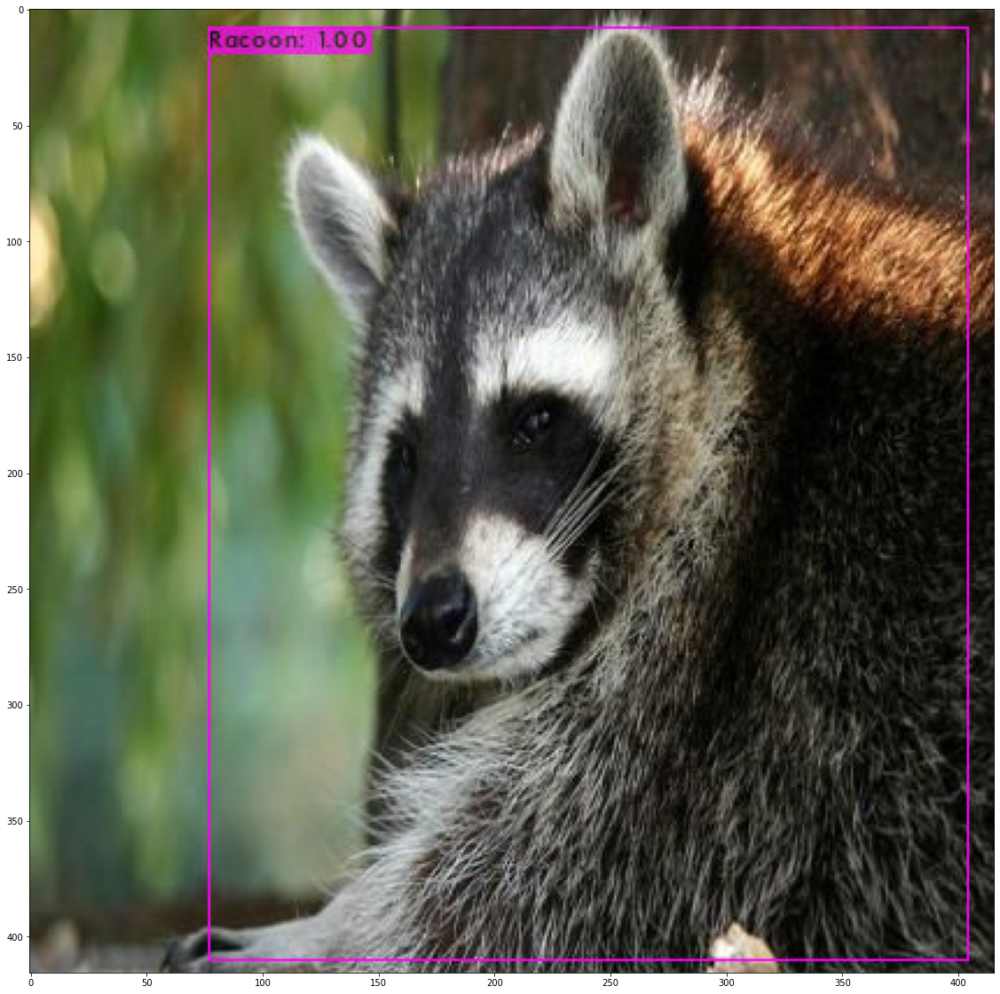

In [ ]:
pred = plt.imread('predictions.jpg')
plt.figure(figsize=(20,20))
plt.imshow(pred)
plt.show()

# 얼굴 영역 crop한 파일 만들기

## 프로젝트 다운로드

In [38]:
%cd {HOME}

/content


In [39]:
!git clone https://github.com/dhrim/darkeras-yolov4

Cloning into 'darkeras-yolov4'...
remote: Enumerating objects: 168, done.
remote: Counting objects: 100% (168/168), done.
remote: Compressing objects: 100% (147/147), done.
remote: Total 168 (delta 83), reused 37 (delta 16), pack-reused 0
Receiving objects: 100% (168/168), 5.57 MiB | 4.96 MiB/s, done.
Resolving deltas: 100% (83/83), done.


In [40]:
%cd darkeras-yolov4

/content/darkeras-yolov4


## 데이터 다운로드

In [41]:
!rm -rf face
!unzip /gdrive/MyDrive/tmp/face/face.zip -d face

Archive:  /gdrive/MyDrive/tmp/face/face.zip
   creating: face/test/
  inflating: face/test/_darknet.labels  
  inflating: face/test/raccoon-57_jpg.rf.26f3fae218f26088f6a7405c58ae8020.jpg  
  inflating: face/test/raccoon-57_jpg.rf.26f3fae218f26088f6a7405c58ae8020.txt  
  inflating: face/test/raccoon-58_jpg.rf.ff9de9977475e0086e7ab582122c5167.jpg  
  inflating: face/test/raccoon-58_jpg.rf.ff9de9977475e0086e7ab582122c5167.txt  
  inflating: face/test/raccoon-59_jpg.rf.388d6dd8c9d5a6fc7ca75790e680c269.jpg  
  inflating: face/test/raccoon-59_jpg.rf.388d6dd8c9d5a6fc7ca75790e680c269.txt  
  inflating: face/test/raccoon-60_jpg.rf.cff8b797e6b5c9b716b6be70be2b6b33.jpg  
  inflating: face/test/raccoon-60_jpg.rf.cff8b797e6b5c9b716b6be70be2b6b33.txt  
  inflating: face/test/raccoon-61_jpg.rf.58c4f561336525f59d395ce21508523b.jpg  
  inflating: face/test/raccoon-61_jpg.rf.58c4f561336525f59d395ce21508523b.txt  
  inflating: face/test/raccoon-62_jpg.rf.e997ede5457f069436178f08065d9a61.jpg  
  inflating

## 모델 로딩

In [43]:
import yolov3_wrapper
detection_model = yolov3_wrapper.YoloV3Wrapper(GDRIVE_PATH+"/"+FACE_DETECTION_MODEL_FILE, class_num=1)

## 얼굴 탐지와 crop 이미지 저장

In [44]:
!mkdir -p {CROPPED_PATH}

In [45]:
import glob
file_list = glob.glob(TARGET_PATH+"/*.jpg")
print(len(file_list))
print(file_list[:2])

150
['face/train/raccoon-4_jpg.rf.87f15f7e193eba4c63363a9e8f698cc7.jpg', 'face/train/raccoon-153_jpg.rf.2a07e150eaf34de78982919f926f6cc4.jpg']


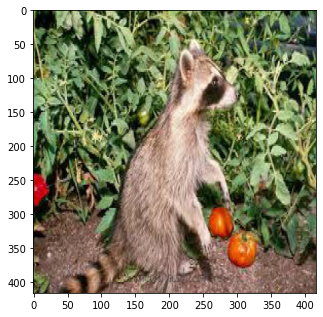

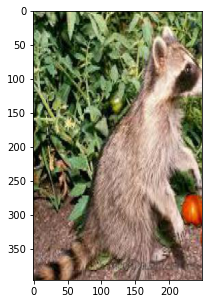

saved as face/train/cropped/raccoon-4_jpg.rf.87f15f7e193eba4c63363a9e8f698cc7_cropped_0.jpg


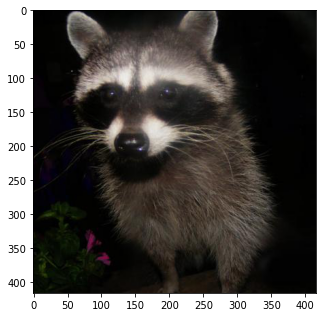

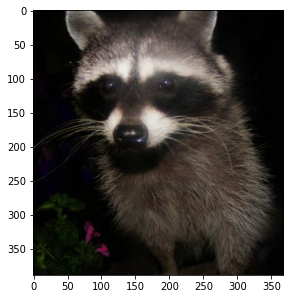

saved as face/train/cropped/raccoon-153_jpg.rf.2a07e150eaf34de78982919f926f6cc4_cropped_0.jpg


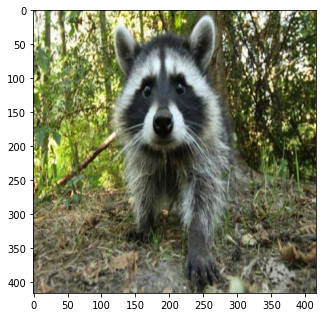

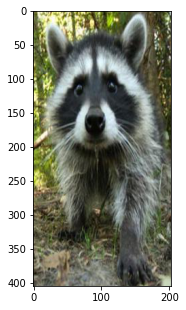

saved as face/train/cropped/raccoon-45_jpg.rf.fa6b0fabef2ed4f9e9dd6b164792d373_cropped_0.jpg


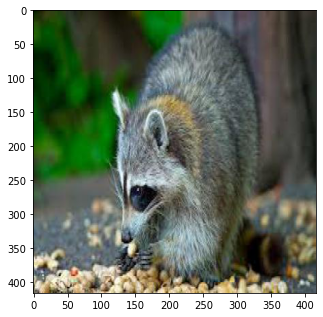

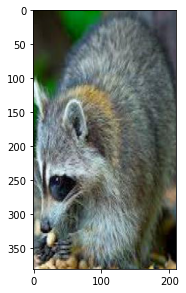

saved as face/train/cropped/raccoon-29_jpg.rf.3789fab26d5503e529af0b5bb132ab91_cropped_0.jpg


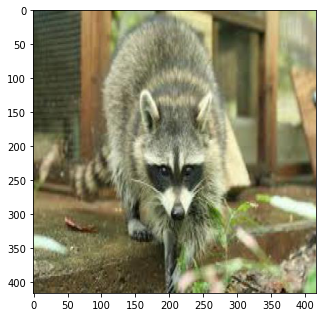

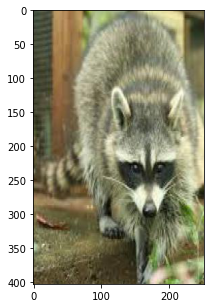

saved as face/train/cropped/raccoon-185_jpg.rf.53089cc4bbef76a8aea5a70b56e56a65_cropped_0.jpg


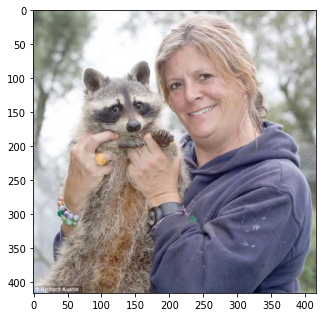

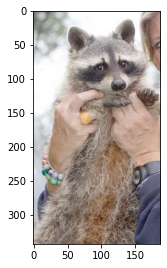

saved as face/train/cropped/raccoon-25_jpg.rf.dada3d74aa39089ede4d16414c45fffa_cropped_0.jpg


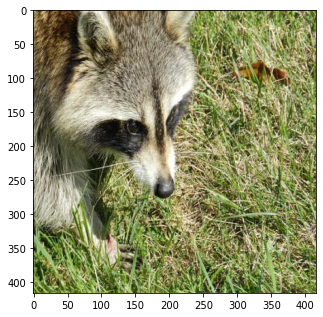

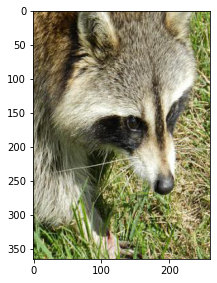

saved as face/train/cropped/raccoon-113_jpg.rf.44c31e8397cc40b9c2355a406f70f597_cropped_0.jpg


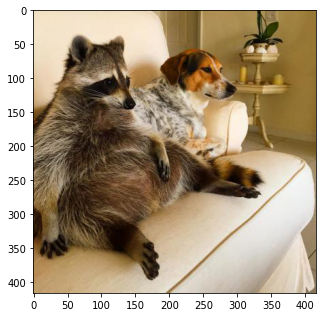

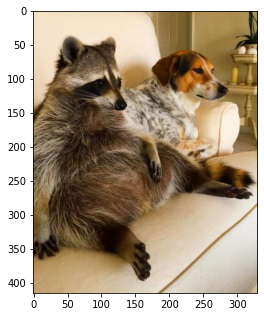

saved as face/train/cropped/raccoon-194_jpg.rf.73825ff9c38622c80dc729027cc27d34_cropped_0.jpg


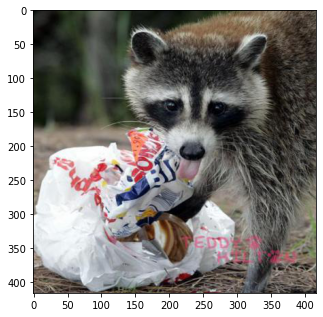

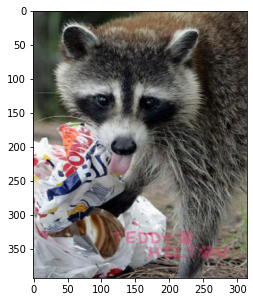

saved as face/train/cropped/raccoon-10_jpg.rf.14ba49f1a3c6391580499dff9cabe176_cropped_0.jpg


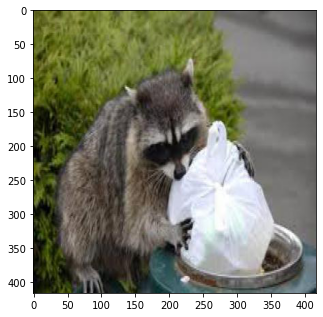

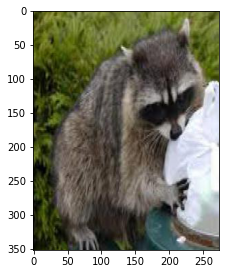

saved as face/train/cropped/raccoon-164_jpg.rf.b668f55ca2ffd629f8fd4298981104f1_cropped_0.jpg


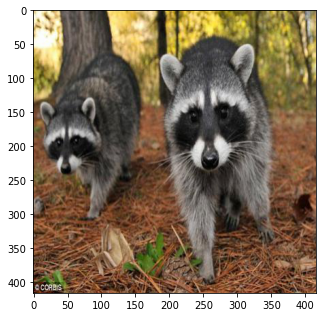

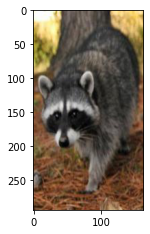

saved as face/train/cropped/raccoon-55_jpg.rf.5b221bf351955c14e80459a380fa2da0_cropped_0.jpg


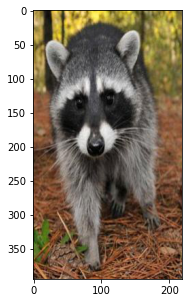

saved as face/train/cropped/raccoon-55_jpg.rf.5b221bf351955c14e80459a380fa2da0_cropped_1.jpg


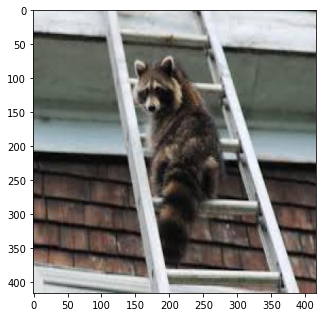

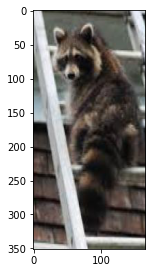

saved as face/train/cropped/raccoon-30_jpg.rf.3d7fec82876cd7ff6f7396c93a59a396_cropped_0.jpg


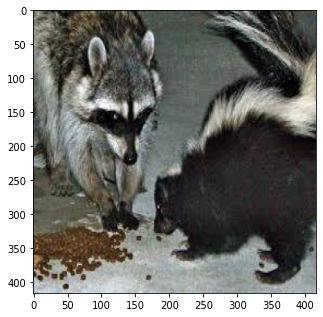

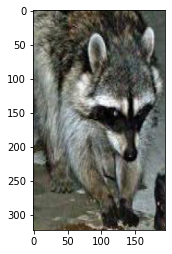

saved as face/train/cropped/raccoon-102_jpg.rf.d140a1fcbfc8d62c7ad37167714f79df_cropped_0.jpg


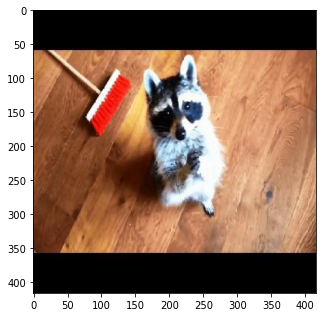

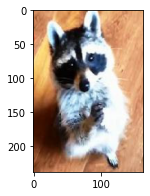

saved as face/train/cropped/raccoon-40_jpg.rf.535961124b91d43679aea1bf572ed169_cropped_0.jpg


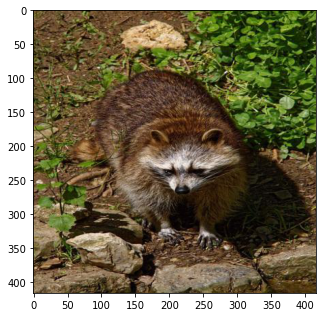

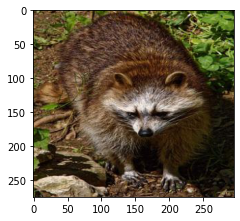

saved as face/train/cropped/raccoon-115_jpg.rf.053146d585dcd8e8ba423a8c81dd5b0a_cropped_0.jpg


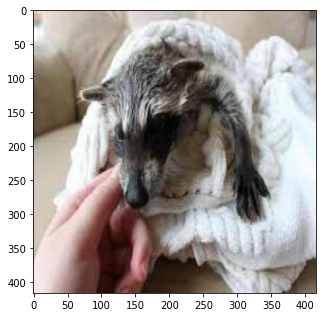

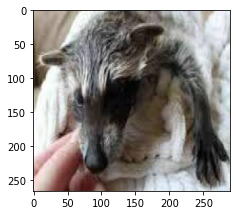

saved as face/train/cropped/raccoon-106_jpg.rf.10f11a11172797e1e1a0ab2db39f7f0f_cropped_0.jpg


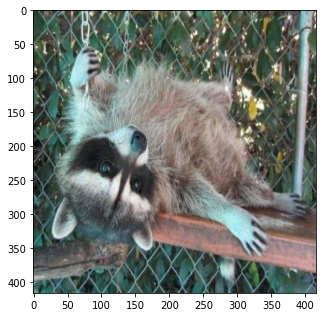

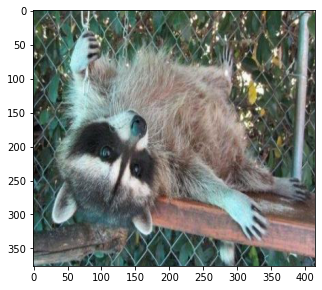

saved as face/train/cropped/raccoon-27_jpg.rf.316935b020d5fd007d7268a72769ae9d_cropped_0.jpg


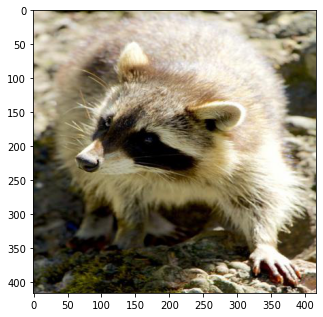

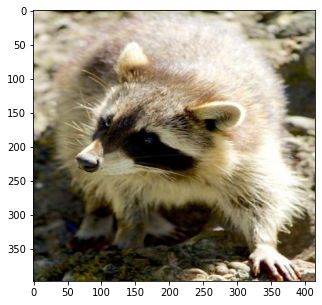

saved as face/train/cropped/raccoon-133_jpg.rf.1904a8ef78ba547bae4bf1904d7dcecf_cropped_0.jpg


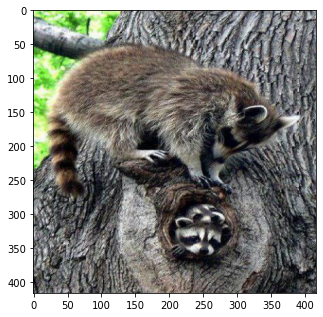

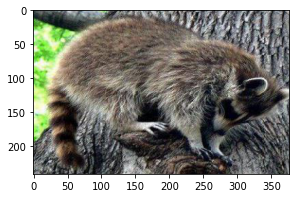

saved as face/train/cropped/raccoon-119_jpg.rf.72a18cd6c7a2b03e30d1088780ddad94_cropped_0.jpg


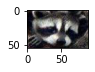

saved as face/train/cropped/raccoon-119_jpg.rf.72a18cd6c7a2b03e30d1088780ddad94_cropped_1.jpg


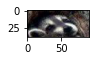

saved as face/train/cropped/raccoon-119_jpg.rf.72a18cd6c7a2b03e30d1088780ddad94_cropped_2.jpg


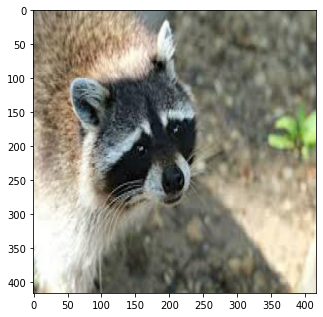

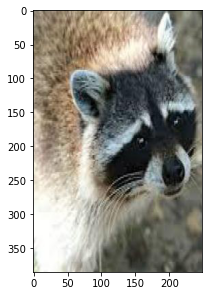

saved as face/train/cropped/raccoon-35_jpg.rf.412f8d6d90c7ea71ea9f6d5f5c7c39c7_cropped_0.jpg


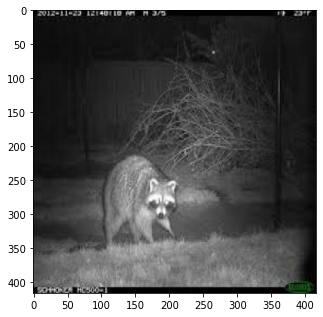

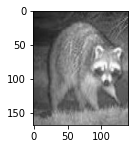

saved as face/train/cropped/raccoon-155_jpg.rf.601b4d9d26e96479d26202797f1f1fa9_cropped_0.jpg


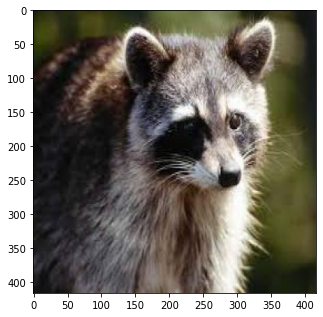

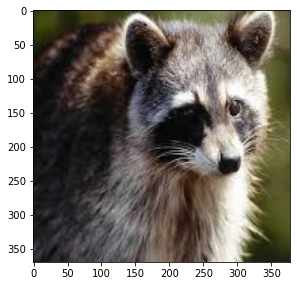

saved as face/train/cropped/raccoon-126_jpg.rf.fee7da8bc1d801b76f703372955388a5_cropped_0.jpg


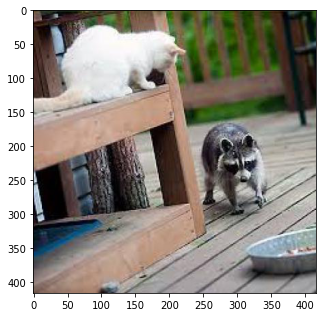

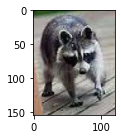

saved as face/train/cropped/raccoon-134_jpg.rf.17aaee25817c82dcccc9982cf2346af1_cropped_0.jpg


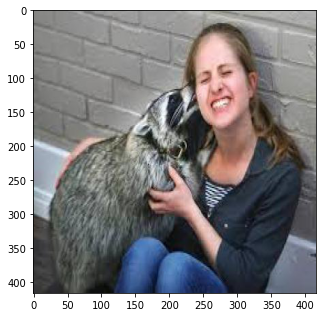

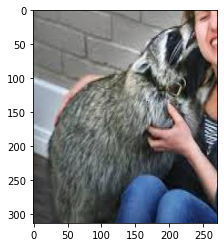

saved as face/train/cropped/raccoon-160_jpg.rf.07d8ec8df1a81403c9bab454dbdb494d_cropped_0.jpg


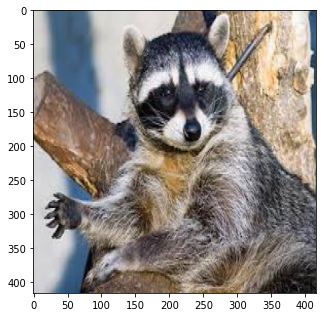

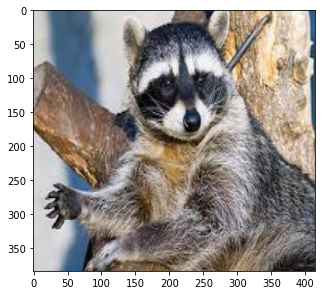

saved as face/train/cropped/raccoon-146_jpg.rf.8a125f9145d9522094fe8a2e16067397_cropped_0.jpg


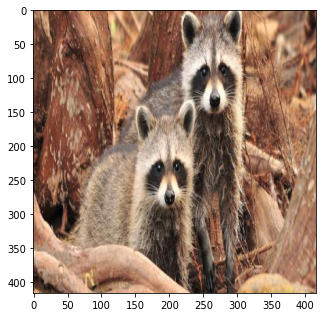

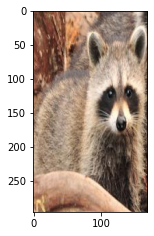

saved as face/train/cropped/raccoon-168_jpg.rf.6409e77ba490144d3c4ccb0fb53f2c9d_cropped_0.jpg


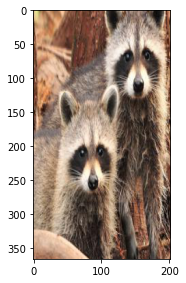

saved as face/train/cropped/raccoon-168_jpg.rf.6409e77ba490144d3c4ccb0fb53f2c9d_cropped_1.jpg


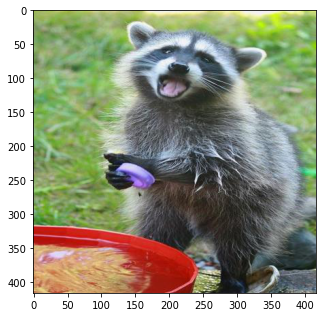

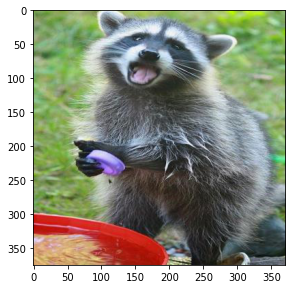

saved as face/train/cropped/raccoon-33_jpg.rf.85235043b0e7fe2f572c7e8939c99024_cropped_0.jpg


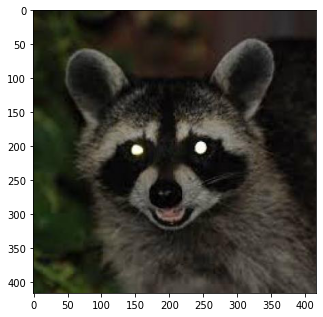

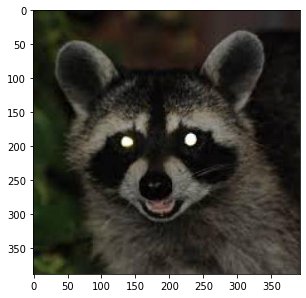

saved as face/train/cropped/raccoon-159_jpg.rf.f00562bbdf4852182fce5c33b9831501_cropped_0.jpg


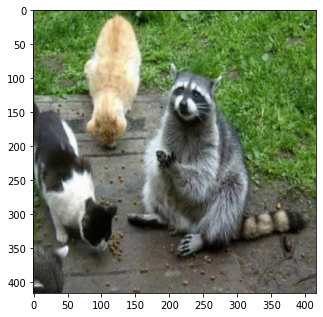

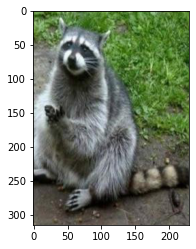

saved as face/train/cropped/raccoon-51_jpg.rf.20fce1e2bf1e589e1d6bc69221a2160b_cropped_0.jpg


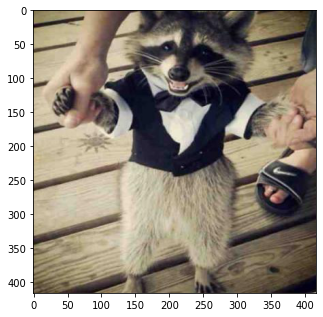

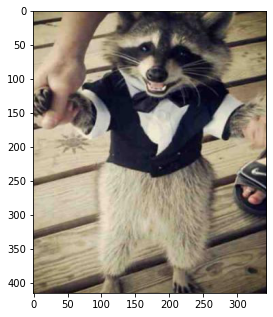

saved as face/train/cropped/raccoon-37_jpg.rf.7d902e8083bbdfc7d78c99ec0690019f_cropped_0.jpg


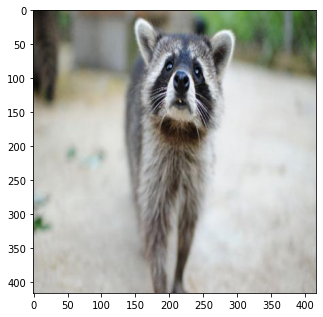

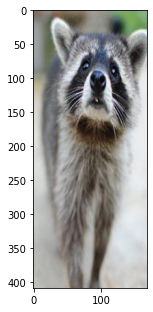

saved as face/train/cropped/raccoon-46_jpg.rf.30eb23c3a2cb5e17bbae0aa6cac707e3_cropped_0.jpg


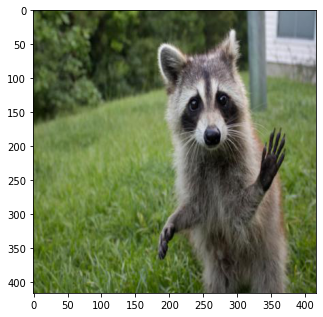

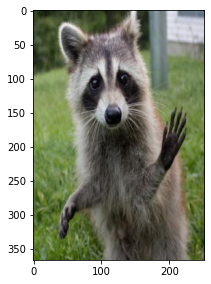

saved as face/train/cropped/raccoon-173_jpg.rf.b1235c6a96f98374990c70d9434000c2_cropped_0.jpg


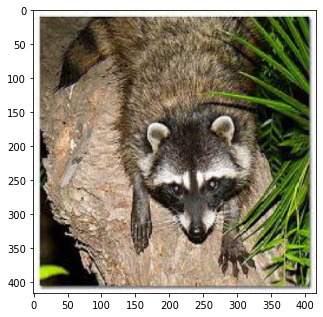

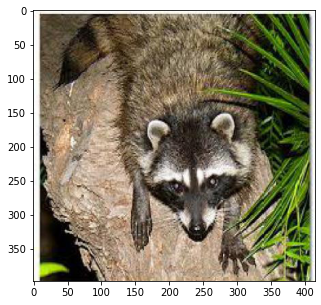

saved as face/train/cropped/raccoon-56_jpg.rf.48fecf103e4a4c814569b50facecf288_cropped_0.jpg


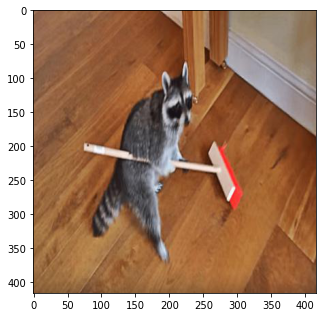

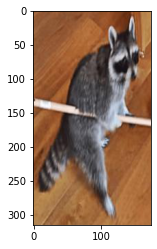

saved as face/train/cropped/raccoon-14_jpg.rf.ccd41578e4ad987071fdc014304b74f4_cropped_0.jpg


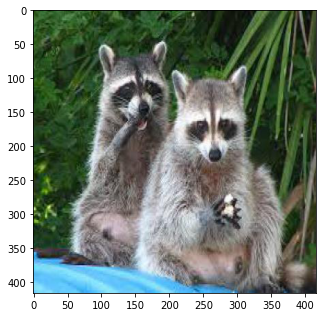

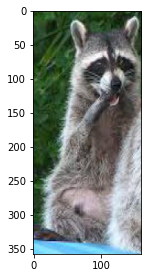

saved as face/train/cropped/raccoon-12_jpg.rf.f244855efb01c95a0cef0d32b66dcc54_cropped_0.jpg


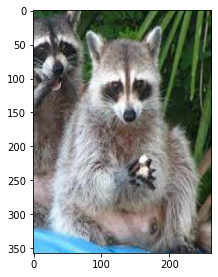

saved as face/train/cropped/raccoon-12_jpg.rf.f244855efb01c95a0cef0d32b66dcc54_cropped_1.jpg


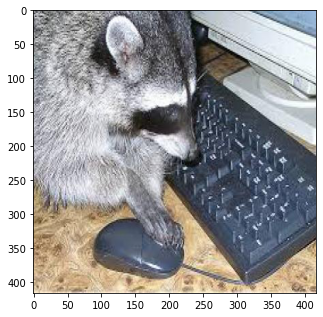

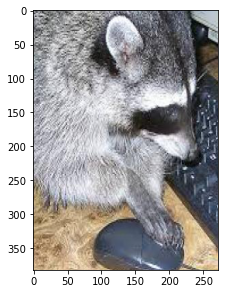

saved as face/train/cropped/raccoon-141_jpg.rf.07e56dba92bd912066d0cf7a54e20290_cropped_0.jpg


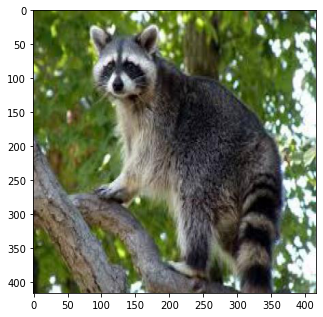

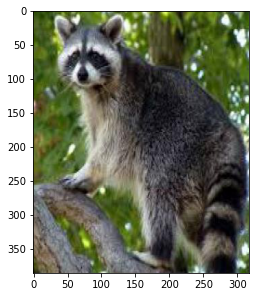

saved as face/train/cropped/raccoon-47_jpg.rf.768641c75d43f2db6ff435e7e2a4bd3d_cropped_0.jpg


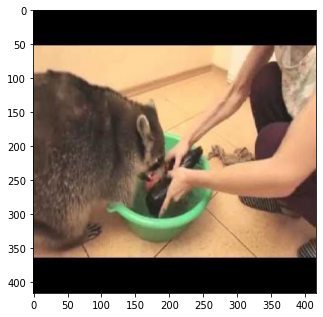

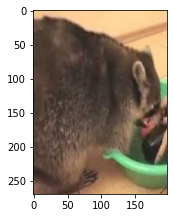

saved as face/train/cropped/raccoon-43_jpg.rf.bc4e3f1c9c25487418260300964e2180_cropped_0.jpg


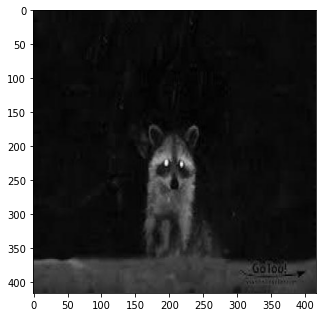

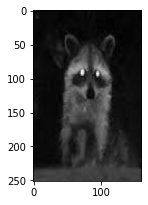

saved as face/train/cropped/raccoon-150_jpg.rf.330597265393c690c4fbff7edf595381_cropped_0.jpg


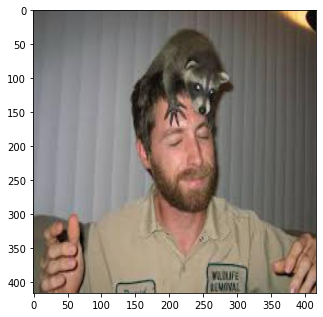

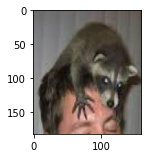

saved as face/train/cropped/raccoon-19_jpg.rf.4b877f79c13c17fa218923084773ec00_cropped_0.jpg


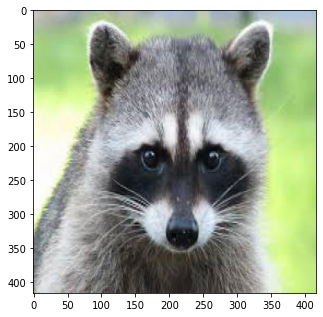

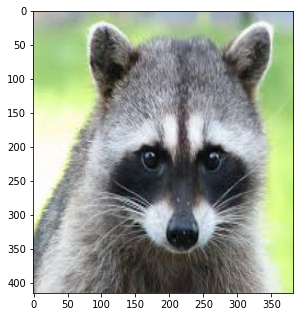

saved as face/train/cropped/raccoon-34_jpg.rf.918c55f154c1b2ef39a41e6085be2434_cropped_0.jpg


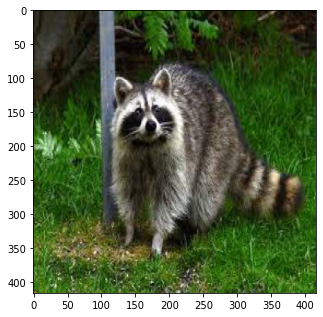

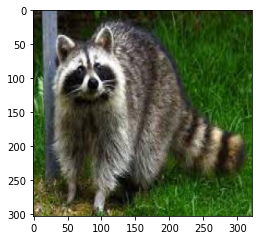

saved as face/train/cropped/raccoon-170_jpg.rf.87c5e9d7e0bd78397063846b0ad329c7_cropped_0.jpg


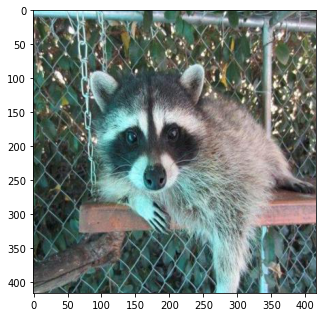

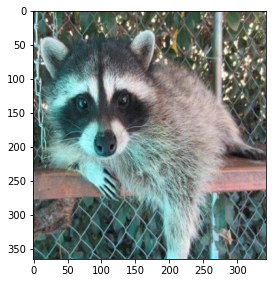

saved as face/train/cropped/raccoon-28_jpg.rf.7b2be1128d5b1d3d43776e878d595a10_cropped_0.jpg


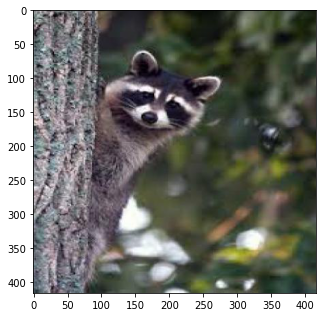

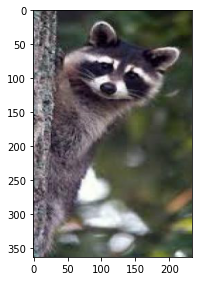

saved as face/train/cropped/raccoon-156_jpg.rf.bf2e87941fc09d382617f414d3c3f6cc_cropped_0.jpg


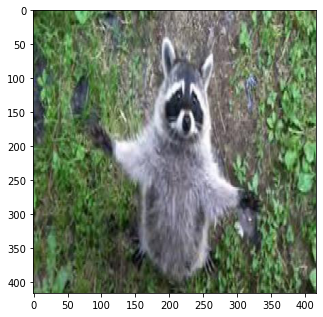

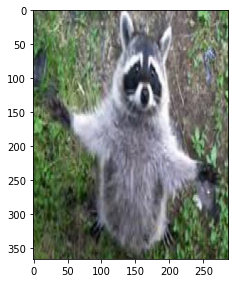

saved as face/train/cropped/raccoon-44_jpg.rf.76519fa3d01a9d19c4e022e98292c60e_cropped_0.jpg


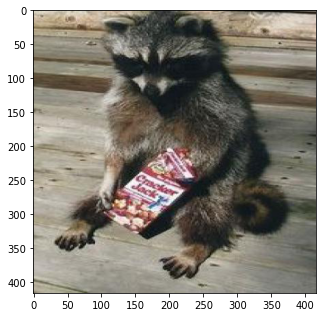

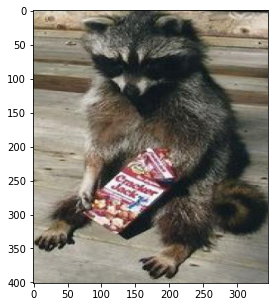

saved as face/train/cropped/raccoon-109_jpg.rf.e0306efe98748d0b3b7859fb9b463f26_cropped_0.jpg


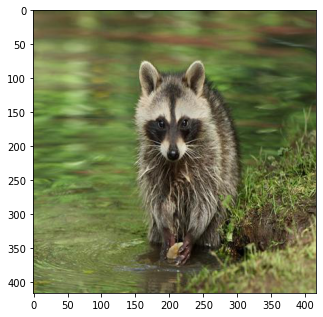

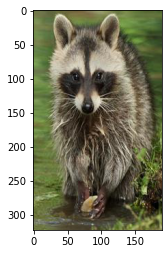

saved as face/train/cropped/raccoon-41_jpg.rf.3e59f7f51aa762bcb23caefb60a8974f_cropped_0.jpg


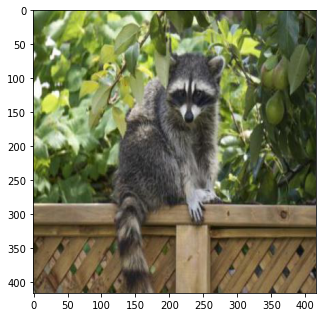

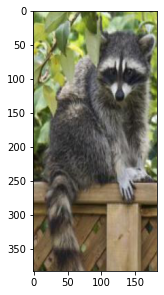

saved as face/train/cropped/raccoon-118_jpg.rf.c56a49568a139f5ff74c14ae8e460970_cropped_0.jpg


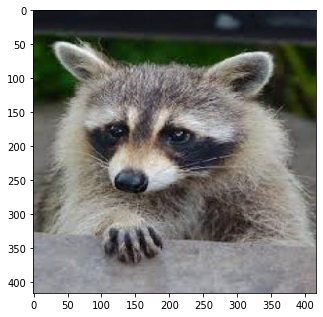

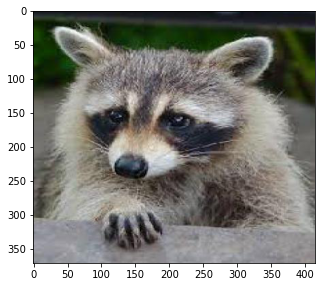

saved as face/train/cropped/raccoon-140_jpg.rf.021c5b27b8cf2e2734530a035d7a3646_cropped_0.jpg


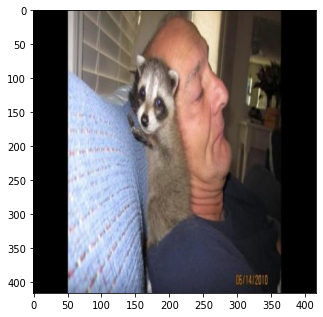

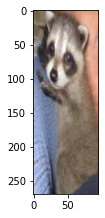

saved as face/train/cropped/raccoon-104_jpg.rf.e5f8de5f977a32d8a7f2223574ff2b72_cropped_0.jpg


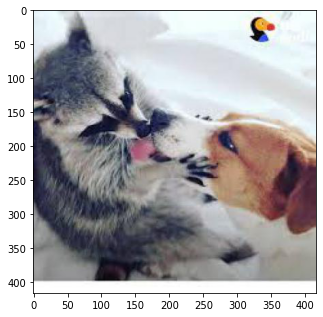

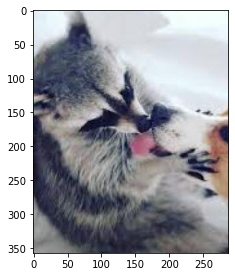

saved as face/train/cropped/raccoon-157_jpg.rf.42e9b274a066a55cee4aadbf3e610f97_cropped_0.jpg


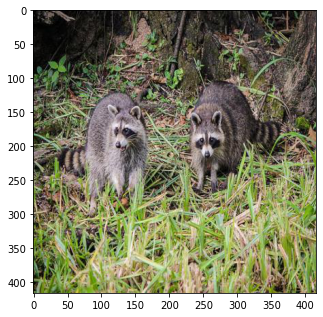

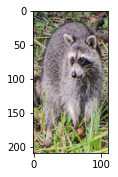

saved as face/train/cropped/raccoon-117_jpg.rf.b05cd921b42a5dda682dcc870518e462_cropped_0.jpg


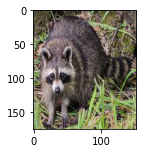

saved as face/train/cropped/raccoon-117_jpg.rf.b05cd921b42a5dda682dcc870518e462_cropped_1.jpg


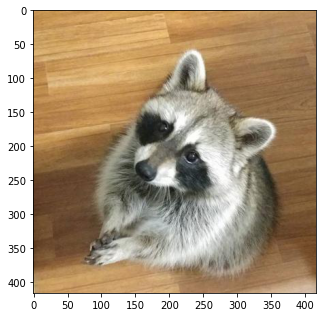

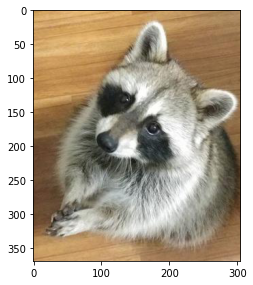

saved as face/train/cropped/raccoon-184_jpg.rf.43059125d060a4ed8ffcf96e9fd11182_cropped_0.jpg


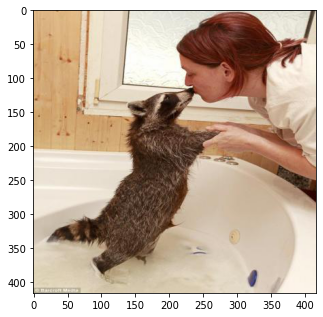

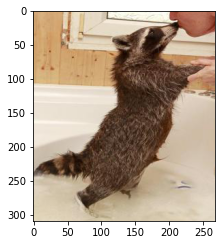

saved as face/train/cropped/raccoon-193_jpg.rf.0f4308408dd14204f9abf6a365fb6f8e_cropped_0.jpg


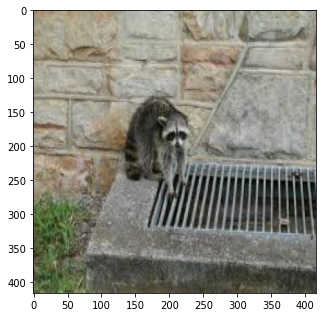

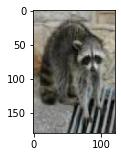

saved as face/train/cropped/raccoon-190_jpg.rf.18c3f6bf1a7b1cd3288edc357d75af5b_cropped_0.jpg


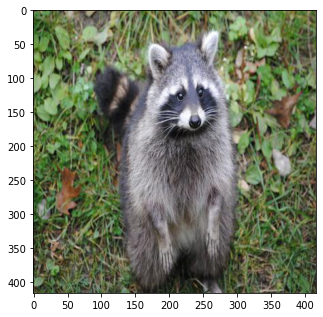

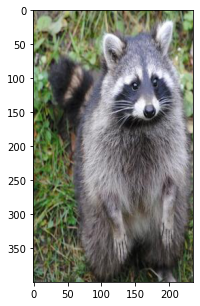

saved as face/train/cropped/raccoon-36_jpg.rf.95f61a0a202157751bc93616034b171d_cropped_0.jpg


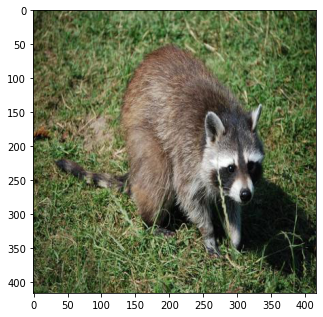

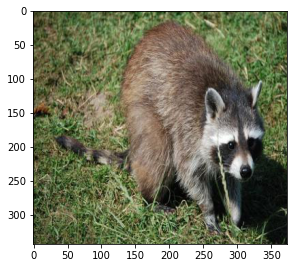

saved as face/train/cropped/raccoon-186_jpg.rf.45717b7fa9e2864677cc082bd988f35f_cropped_0.jpg


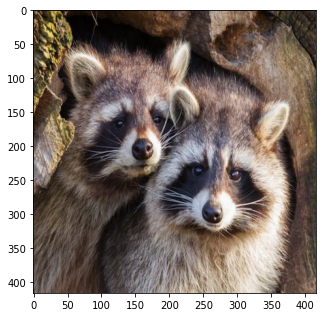

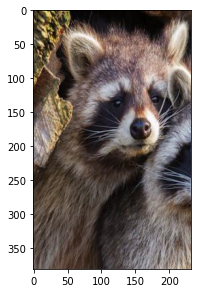

saved as face/train/cropped/raccoon-145_jpg.rf.94d190d1aa954302de0f4a18cac2bc96_cropped_0.jpg


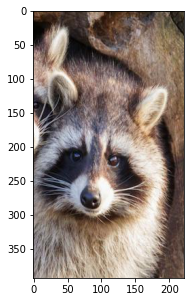

saved as face/train/cropped/raccoon-145_jpg.rf.94d190d1aa954302de0f4a18cac2bc96_cropped_1.jpg


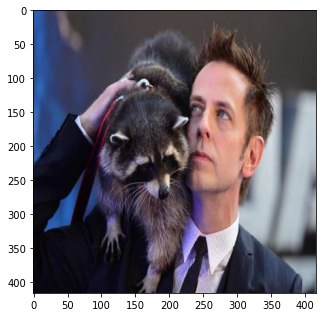

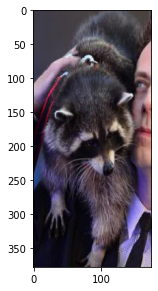

saved as face/train/cropped/raccoon-180_jpg.rf.2a518477d077cb8a36c1af37d3b9a215_cropped_0.jpg


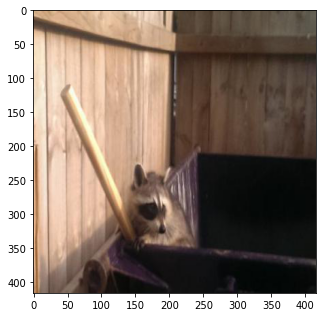

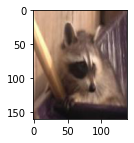

saved as face/train/cropped/raccoon-192_jpg.rf.54d1fc9c2cc03814000b6071ba37e9ab_cropped_0.jpg


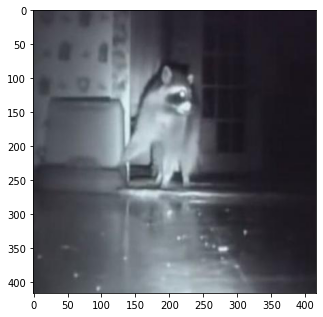

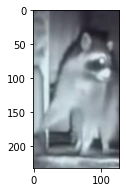

saved as face/train/cropped/raccoon-149_jpg.rf.70664e11725b4721cc466510f117e48e_cropped_0.jpg


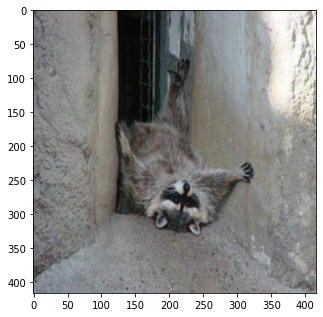

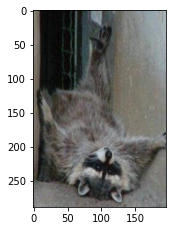

saved as face/train/cropped/raccoon-154_jpg.rf.09b18118aa2799acb05daa90de6a7e60_cropped_0.jpg


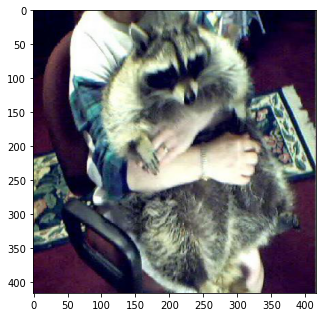

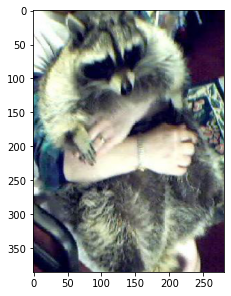

saved as face/train/cropped/raccoon-137_jpg.rf.a67b07d859ac058643915ff7161e6c90_cropped_0.jpg


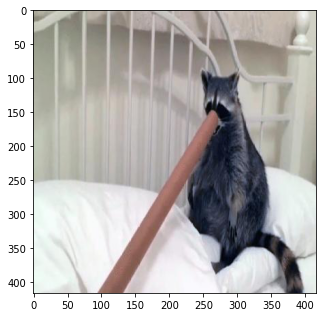

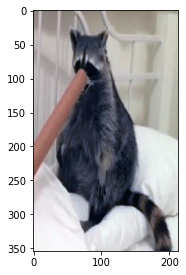

saved as face/train/cropped/raccoon-15_jpg.rf.32c1c6da4b613bddace4a4ebb4a2be44_cropped_0.jpg


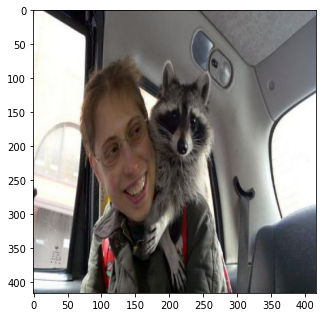

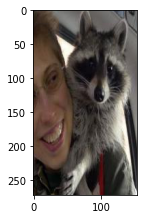

saved as face/train/cropped/raccoon-172_jpg.rf.fe8d3321da448a533f6e3dde44ddda8c_cropped_0.jpg


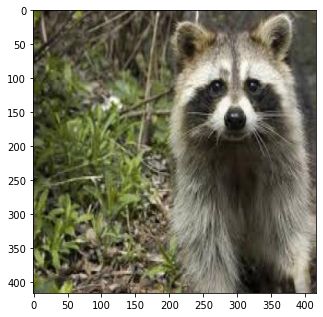

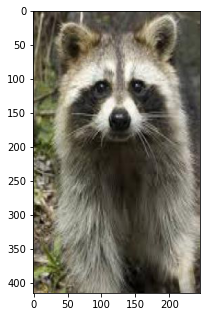

saved as face/train/cropped/raccoon-23_jpg.rf.69d0e4ab322789ad3e2bfdcd933233ad_cropped_0.jpg


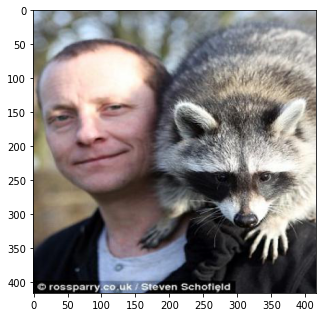

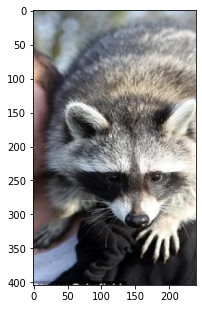

saved as face/train/cropped/raccoon-26_jpg.rf.ab207a81a546038c33a728a96bf86d14_cropped_0.jpg


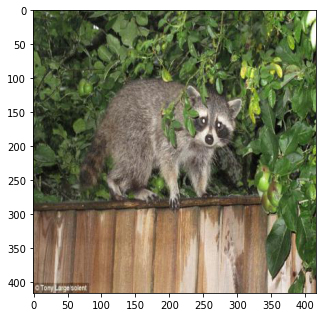

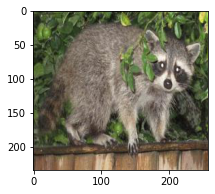

saved as face/train/cropped/raccoon-191_jpg.rf.1eff00dfe69cf22ac7d5b71d9ad82093_cropped_0.jpg


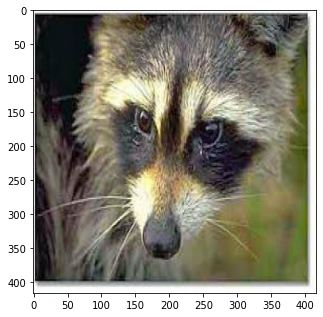

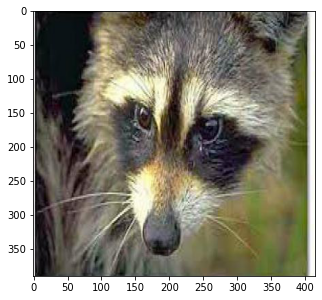

saved as face/train/cropped/raccoon-5_jpg.rf.aada59e008ebcd0aa1300d27a9539feb_cropped_0.jpg


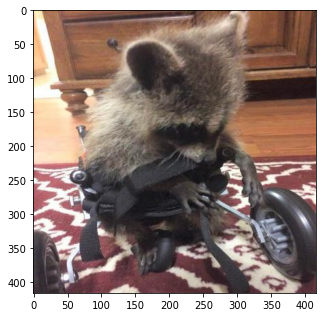

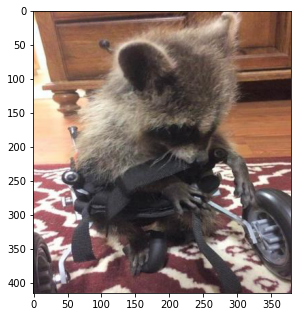

saved as face/train/cropped/raccoon-111_jpg.rf.27a8d7842380860ac1580682e18ee0f2_cropped_0.jpg


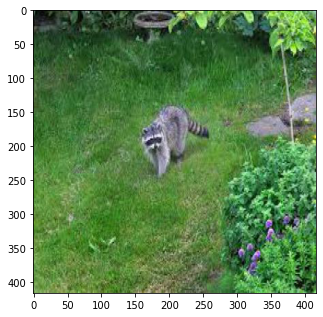

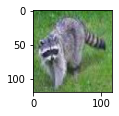

saved as face/train/cropped/raccoon-17_jpg.rf.9a6f703c15e45c2d8e7beb2672336e90_cropped_0.jpg


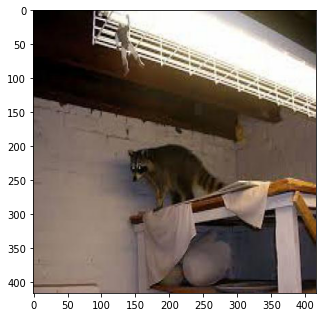

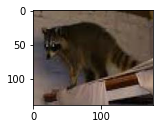

saved as face/train/cropped/raccoon-128_jpg.rf.d69ad1a11a7823bd0e3818419b1071d8_cropped_0.jpg


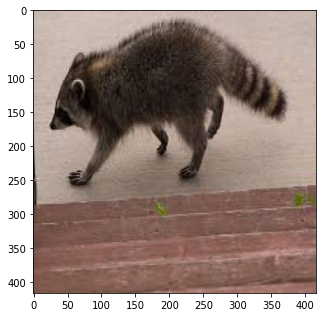

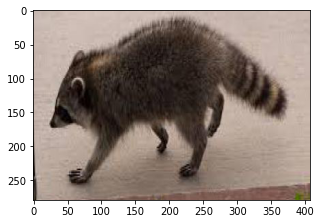

saved as face/train/cropped/raccoon-132_jpg.rf.0b354b87c7cf8e0bbaf011e22bce215b_cropped_0.jpg


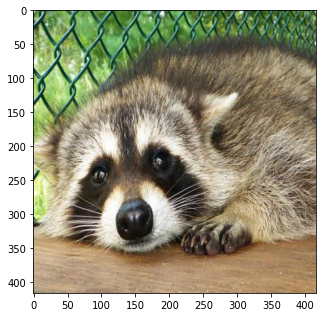

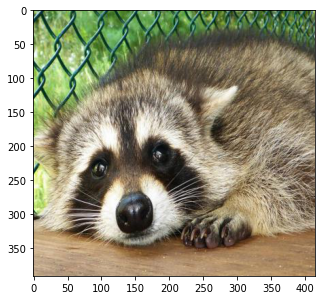

saved as face/train/cropped/raccoon-20_jpg.rf.fb19aa368c074a61eed8829617ed6b7c_cropped_0.jpg


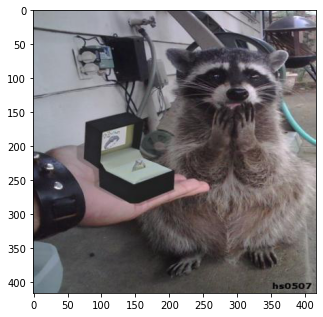

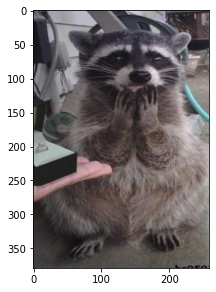

saved as face/train/cropped/raccoon-107_jpg.rf.fcfeeca4a65ce335eaaf55935489ff4e_cropped_0.jpg


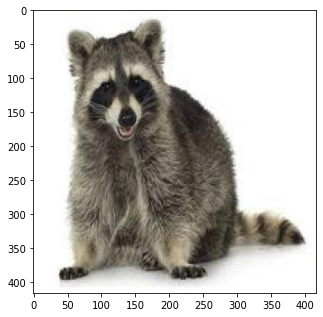

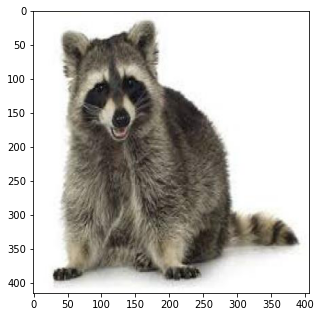

saved as face/train/cropped/raccoon-125_jpg.rf.095796456c02641f5442fe988b190a32_cropped_0.jpg


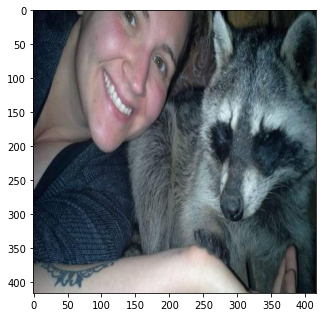

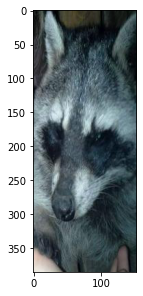

saved as face/train/cropped/raccoon-100_jpg.rf.e9338202a924dc489ffd94e0291a0f39_cropped_0.jpg


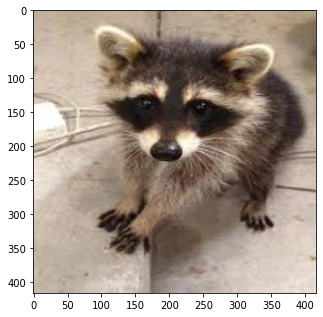

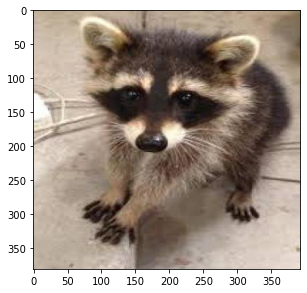

saved as face/train/cropped/raccoon-165_jpg.rf.cc8c1c4c613c5cb96148f31f64b0a738_cropped_0.jpg


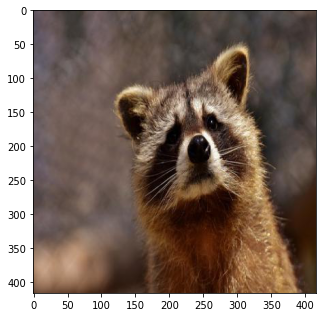

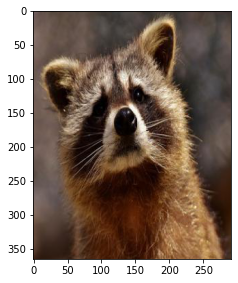

saved as face/train/cropped/raccoon-49_jpg.rf.0c7ec1e43e783a62a23ab81b96aa7366_cropped_0.jpg


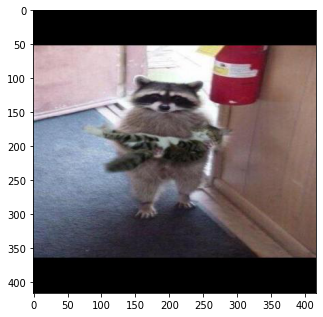

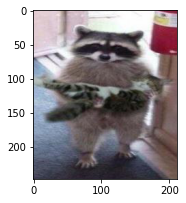

saved as face/train/cropped/raccoon-42_jpg.rf.ba5583e11220792d39341e7eed4f9385_cropped_0.jpg


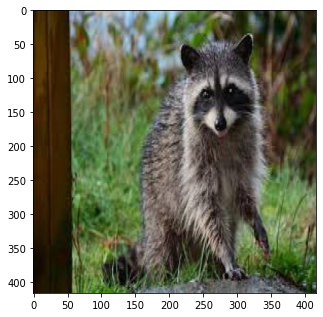

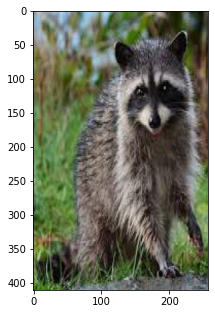

saved as face/train/cropped/raccoon-178_jpg.rf.8c07568eb5114c00e77b073cccc719c6_cropped_0.jpg


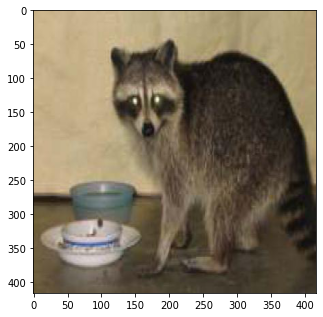

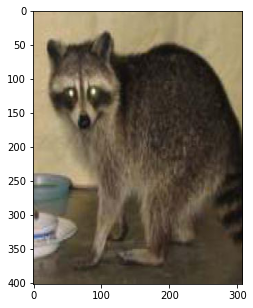

saved as face/train/cropped/raccoon-39_jpg.rf.e3e19cc56f672e57edb42749564d2a3d_cropped_0.jpg


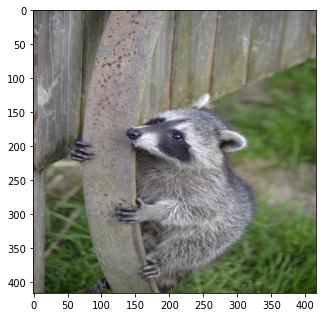

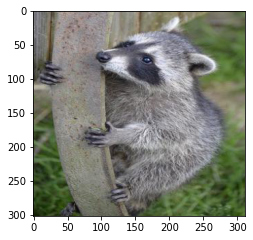

saved as face/train/cropped/raccoon-16_jpg.rf.2910e438d93b6c4ee7a49aaaf63a1f4c_cropped_0.jpg


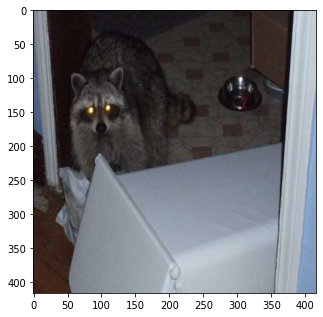

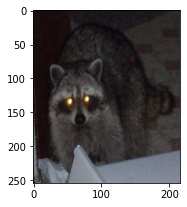

saved as face/train/cropped/raccoon-13_jpg.rf.b553d6d2cc3f79ec70af325742125e41_cropped_0.jpg


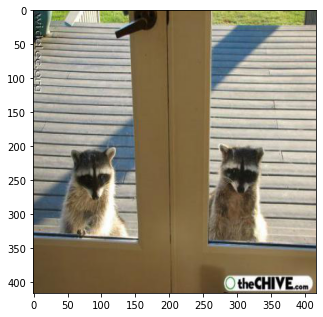

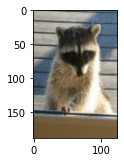

saved as face/train/cropped/raccoon-148_jpg.rf.93538e05d17b33d08bde474a425b5b2d_cropped_0.jpg


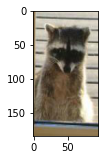

saved as face/train/cropped/raccoon-148_jpg.rf.93538e05d17b33d08bde474a425b5b2d_cropped_1.jpg


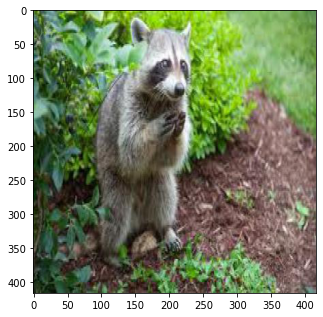

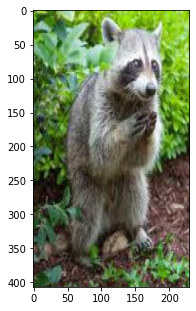

saved as face/train/cropped/raccoon-50_jpg.rf.43389448512823c509aa0a11e769e7e8_cropped_0.jpg


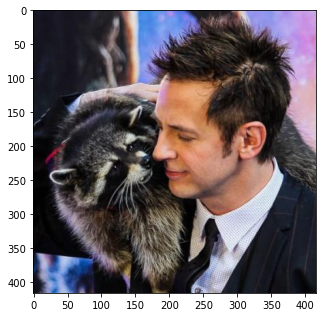

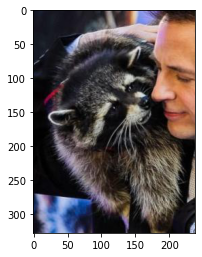

saved as face/train/cropped/raccoon-182_jpg.rf.0ee4a4d4fa828093cffc43bc3ea07a8e_cropped_0.jpg


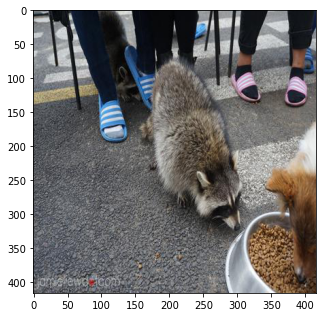

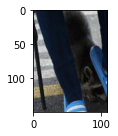

saved as face/train/cropped/raccoon-176_jpg.rf.710df90ee6b4d97ad62923a0a38517f5_cropped_0.jpg


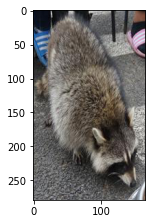

saved as face/train/cropped/raccoon-176_jpg.rf.710df90ee6b4d97ad62923a0a38517f5_cropped_1.jpg


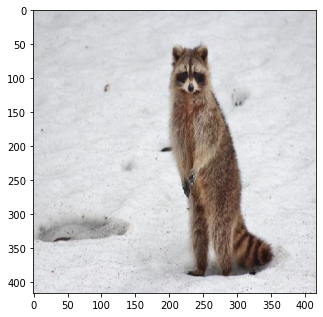

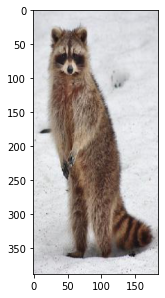

saved as face/train/cropped/raccoon-123_jpg.rf.86bc73224f4a7b91376dd68b12892e3c_cropped_0.jpg


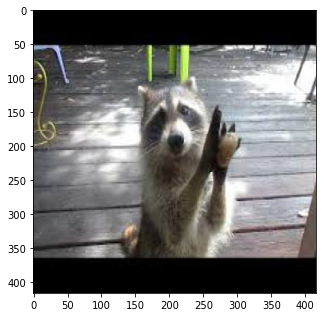

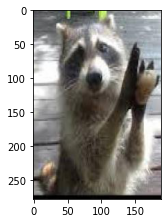

saved as face/train/cropped/raccoon-53_jpg.rf.3372db4c1f0fa75805262eaad064a3f7_cropped_0.jpg


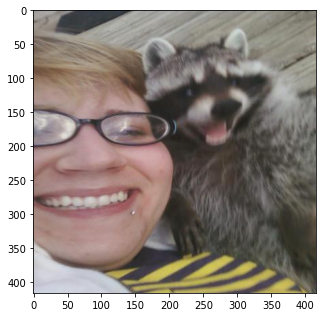

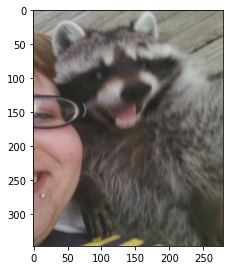

saved as face/train/cropped/raccoon-105_jpg.rf.73bb0ca933f4a5d8e47ee57c46617cd7_cropped_0.jpg


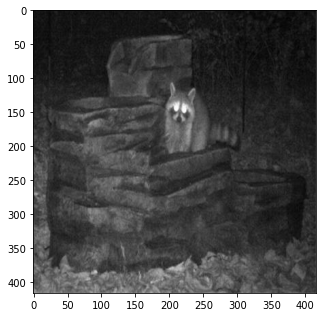

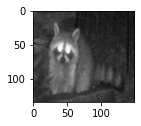

saved as face/train/cropped/raccoon-161_jpg.rf.e8ff1acd5614eb0c53fe51d4c38db3cd_cropped_0.jpg


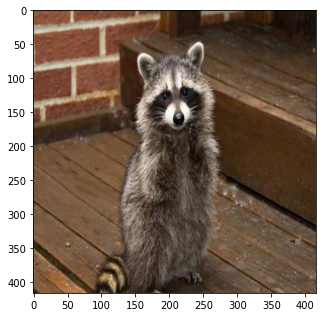

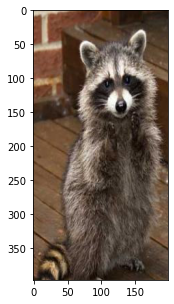

saved as face/train/cropped/raccoon-144_jpg.rf.20b9bea695b9d1ed719968c1f41a0d62_cropped_0.jpg


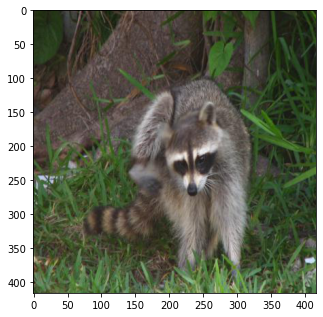

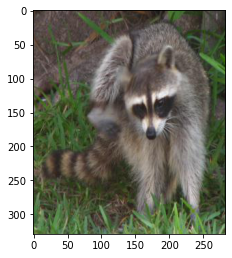

saved as face/train/cropped/raccoon-142_jpg.rf.c3f459d88a59381fcfee3677549778c7_cropped_0.jpg


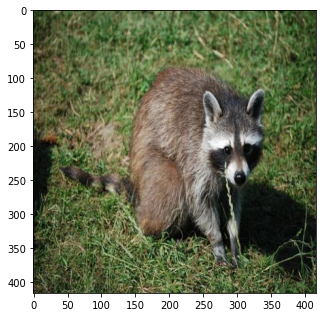

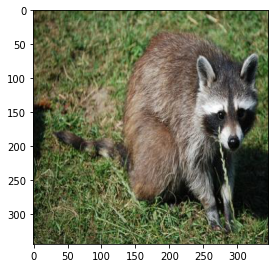

saved as face/train/cropped/raccoon-199_jpg.rf.827e00d23cc83c841e24e17399268364_cropped_0.jpg


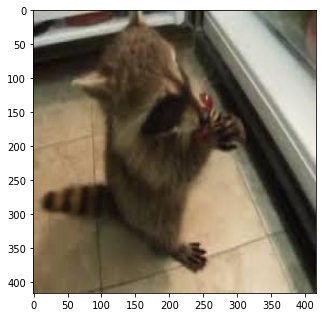

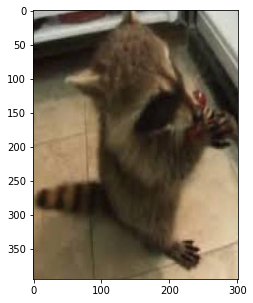

saved as face/train/cropped/raccoon-131_jpg.rf.abdd5f18ff49a86f887e2de9fb682bfa_cropped_0.jpg


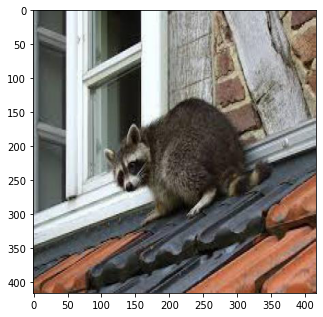

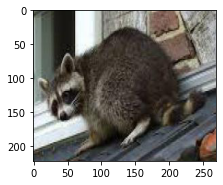

saved as face/train/cropped/raccoon-138_jpg.rf.e8bafcdbf762d97f0236f84c2d08295d_cropped_0.jpg


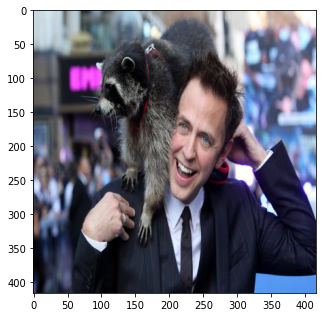

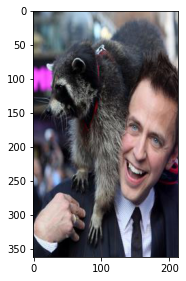

saved as face/train/cropped/raccoon-183_jpg.rf.ec95835ea04533da42d4d959d6707f20_cropped_0.jpg


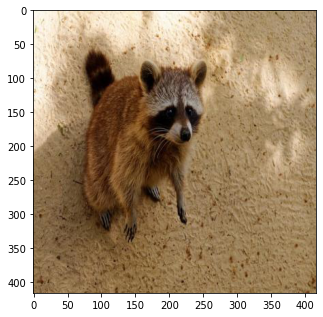

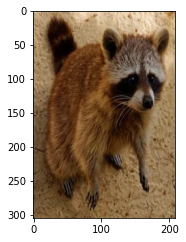

saved as face/train/cropped/raccoon-101_jpg.rf.a9e8a95f51d60d7d3b40d3243aa11afd_cropped_0.jpg


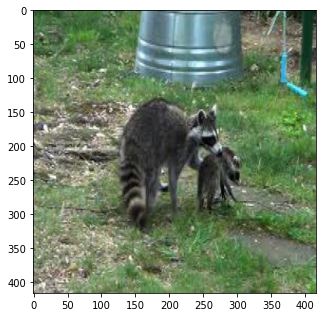

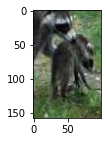

saved as face/train/cropped/raccoon-24_jpg.rf.0778be28363352e342bd9494e7976a7e_cropped_0.jpg


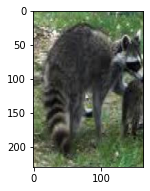

saved as face/train/cropped/raccoon-24_jpg.rf.0778be28363352e342bd9494e7976a7e_cropped_1.jpg


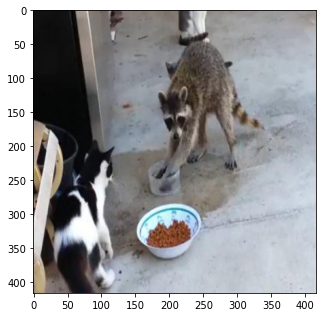

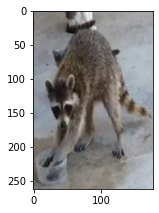

saved as face/train/cropped/raccoon-114_jpg.rf.61a417d19d8044073beb206aa2db9f44_cropped_0.jpg


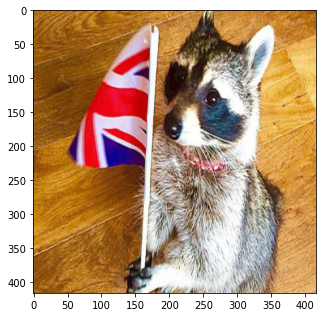

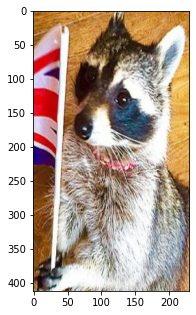

saved as face/train/cropped/raccoon-169_jpg.rf.fcaebc6d02b2e9af8e353c1b5bae8244_cropped_0.jpg


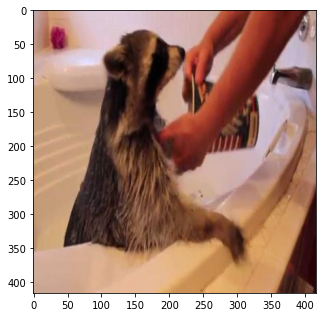

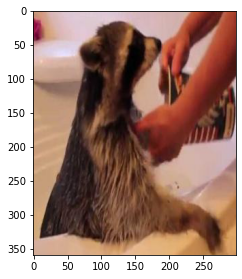

saved as face/train/cropped/raccoon-197_jpg.rf.feeda892bbf59049f5db5eecfb476ffd_cropped_0.jpg


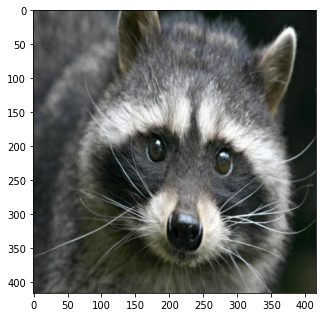

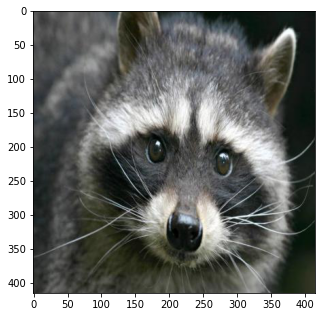

saved as face/train/cropped/raccoon-3_jpg.rf.f876204db5f3b5622bc9e53f65b3452e_cropped_0.jpg


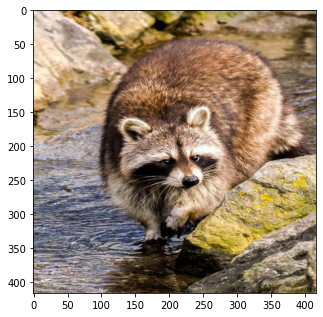

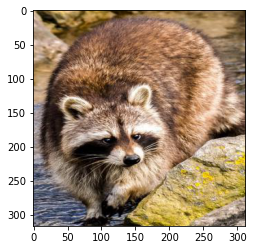

saved as face/train/cropped/raccoon-103_jpg.rf.7148e5c7d785760fe9cb6b7762180977_cropped_0.jpg


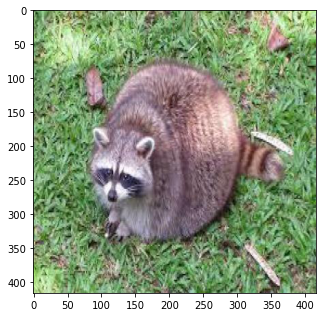

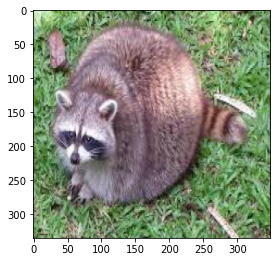

saved as face/train/cropped/raccoon-48_jpg.rf.99c91ae214e78cb740bfd2bca7b82cfe_cropped_0.jpg


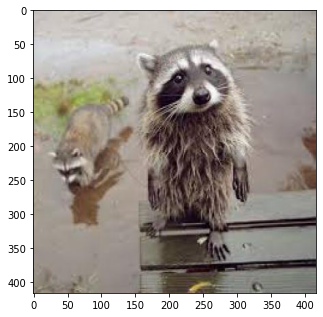

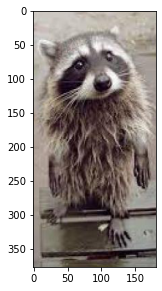

saved as face/train/cropped/raccoon-31_jpg.rf.2e8fd57b2645856e968e01b729ab0c53_cropped_0.jpg


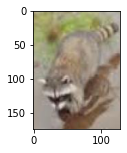

saved as face/train/cropped/raccoon-31_jpg.rf.2e8fd57b2645856e968e01b729ab0c53_cropped_1.jpg


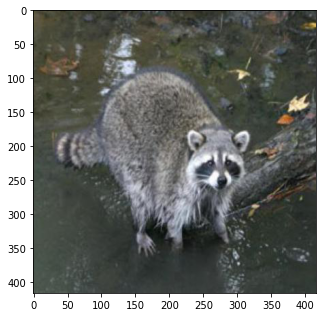

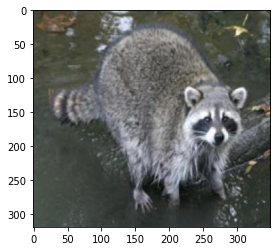

saved as face/train/cropped/raccoon-188_jpg.rf.f994d290893cde25fcb152b2f3cdecf0_cropped_0.jpg


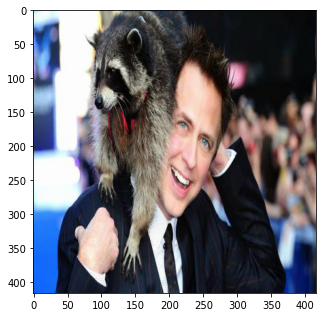

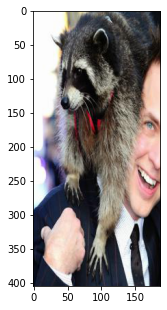

saved as face/train/cropped/raccoon-181_jpg.rf.ae3fcbba8b7e2408d045a865027c34fc_cropped_0.jpg


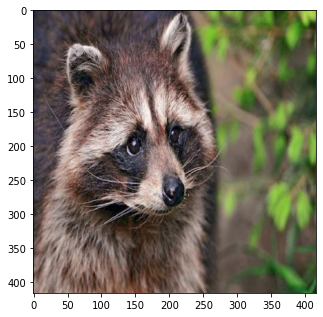

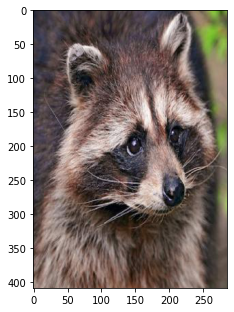

saved as face/train/cropped/raccoon-11_jpg.rf.2610060ad22fcea7c4ae086f903c5eec_cropped_0.jpg


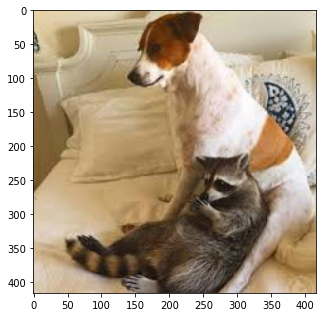

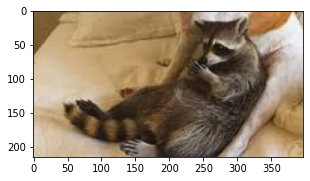

saved as face/train/cropped/raccoon-195_jpg.rf.438757fc784e4d9f04d8c257fa103283_cropped_0.jpg


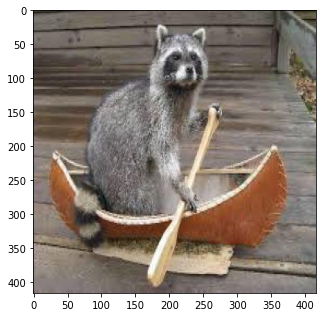

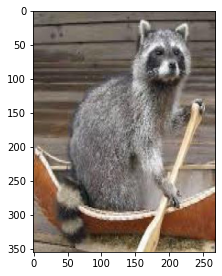

saved as face/train/cropped/raccoon-139_jpg.rf.069e8c7f0a7485402ef0ad5813b743b9_cropped_0.jpg


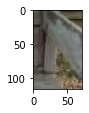

saved as face/train/cropped/raccoon-139_jpg.rf.069e8c7f0a7485402ef0ad5813b743b9_cropped_1.jpg


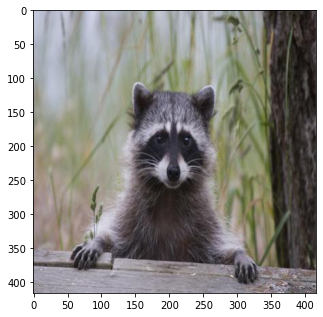

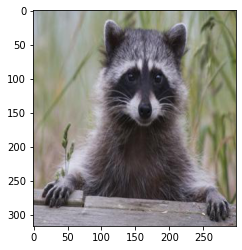

saved as face/train/cropped/raccoon-1_jpg.rf.4735f8b019bd0bfa86593b474aa7a5fa_cropped_0.jpg


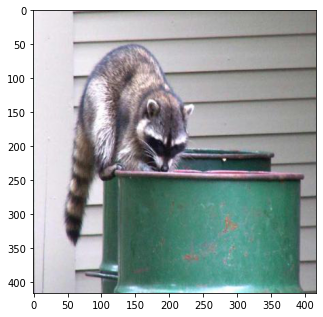

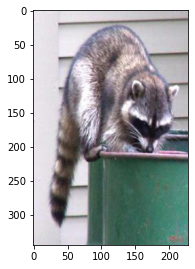

saved as face/train/cropped/raccoon-2_jpg.rf.1d070475673b53b1880a4b5551dae643_cropped_0.jpg


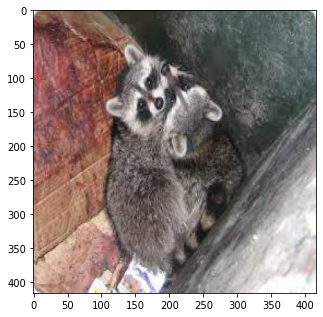

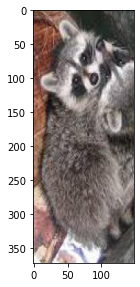

saved as face/train/cropped/raccoon-198_jpg.rf.6911aef3b0e22d84a8b6c19e1b504136_cropped_0.jpg


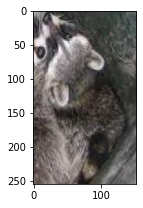

saved as face/train/cropped/raccoon-198_jpg.rf.6911aef3b0e22d84a8b6c19e1b504136_cropped_1.jpg


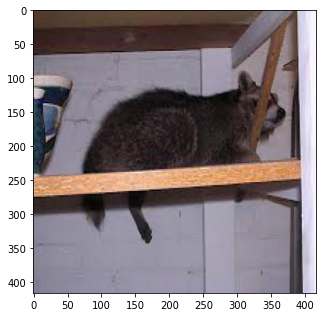

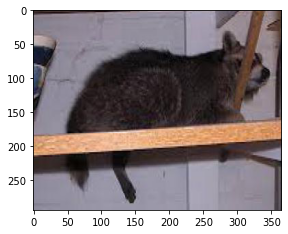

saved as face/train/cropped/raccoon-143_jpg.rf.d75bca7db247c692bfacd20a587832da_cropped_0.jpg


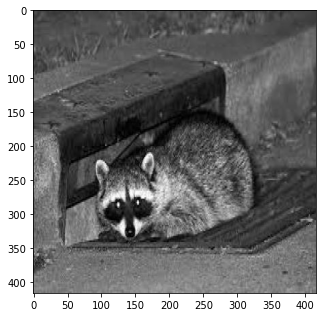

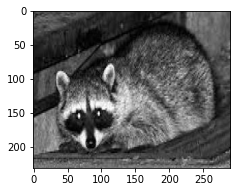

saved as face/train/cropped/raccoon-152_jpg.rf.dcee9be6791185d580a7c06474e1e206_cropped_0.jpg


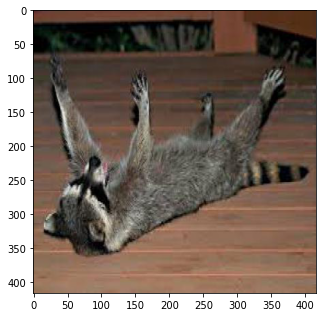

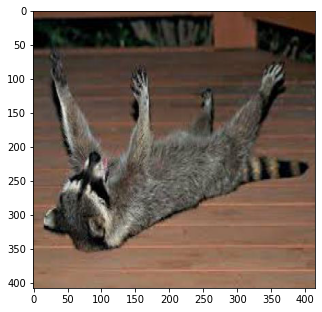

saved as face/train/cropped/raccoon-38_jpg.rf.d72bfc74df002a90d04736fa40265fd9_cropped_0.jpg


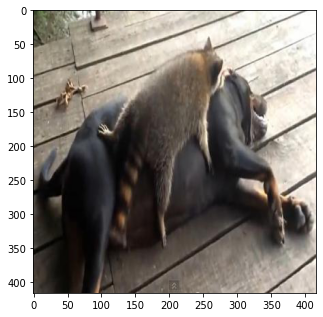

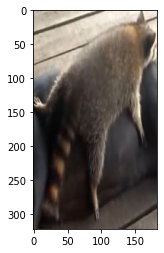

saved as face/train/cropped/raccoon-129_jpg.rf.93bae4d33ef5e605e19f822e8847875f_cropped_0.jpg


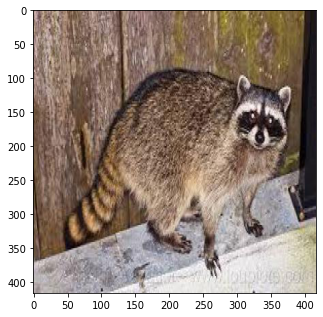

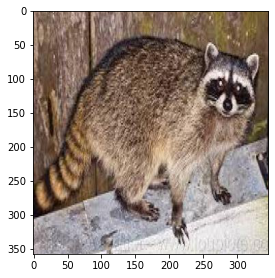

saved as face/train/cropped/raccoon-158_jpg.rf.f55a14ab6a3f4b94626a909bd6c829d4_cropped_0.jpg


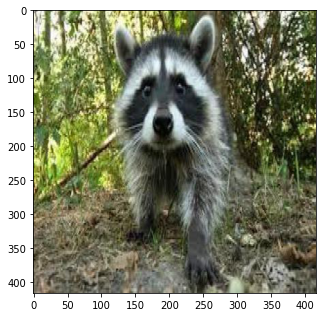

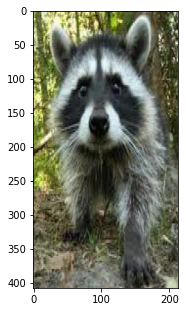

saved as face/train/cropped/raccoon-21_jpg.rf.1a912c8d6424050610135e493cfb5181_cropped_0.jpg


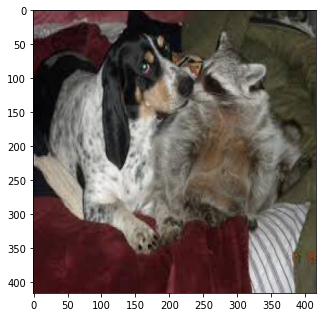

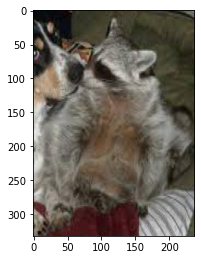

saved as face/train/cropped/raccoon-200_jpg.rf.4d4cf20c6490045c87cadf8bd468bd8f_cropped_0.jpg


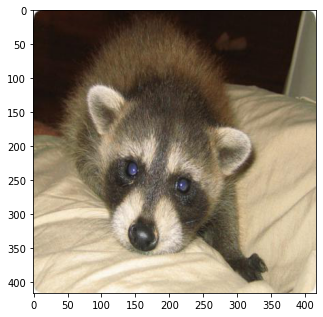

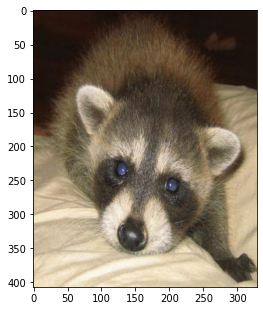

saved as face/train/cropped/raccoon-189_jpg.rf.3dde48ace4f382d50088d9cf494f8d21_cropped_0.jpg


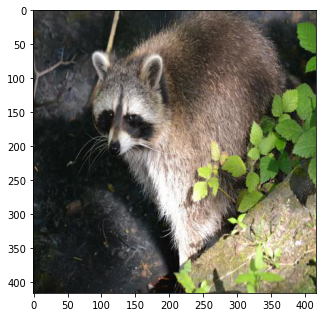

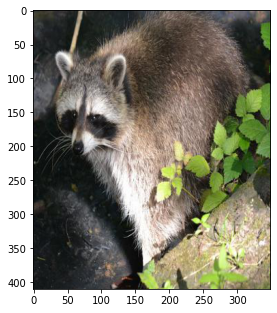

saved as face/train/cropped/raccoon-135_jpg.rf.53470fb941a98a4192e22cff42802563_cropped_0.jpg


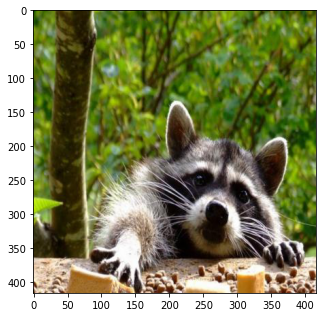

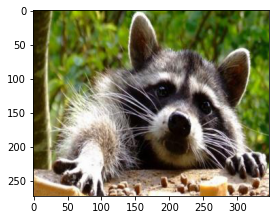

saved as face/train/cropped/raccoon-112_jpg.rf.096e4a5594f3bc496cd5d3d7379e97e0_cropped_0.jpg


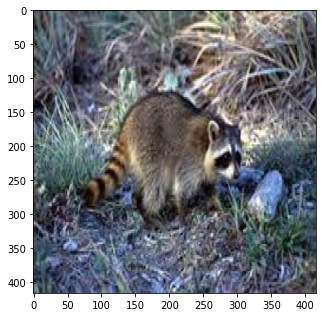

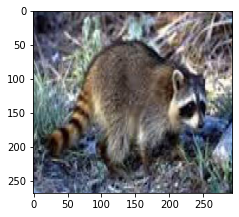

saved as face/train/cropped/raccoon-18_jpg.rf.a89b15cc2d03110d1c2503a6ff5dedb4_cropped_0.jpg


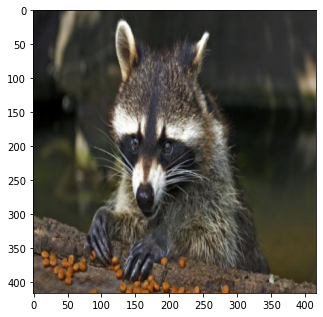

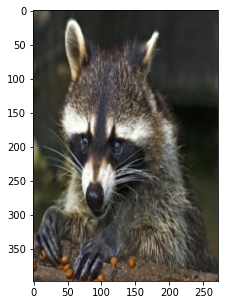

saved as face/train/cropped/raccoon-54_jpg.rf.7499d29f80c5747ee957116f25592ae0_cropped_0.jpg


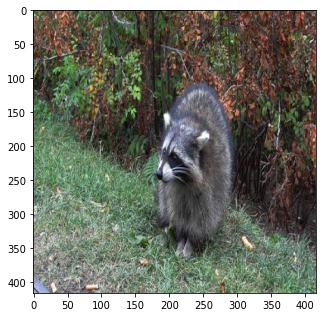

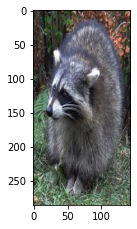

saved as face/train/cropped/raccoon-22_jpg.rf.61a989ae36b537bf441a2c519bfc2791_cropped_0.jpg


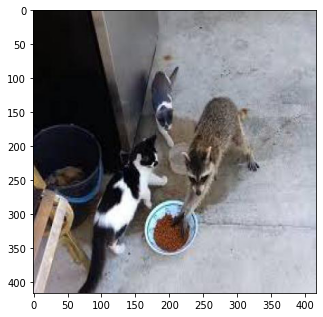

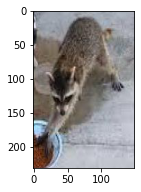

saved as face/train/cropped/raccoon-127_jpg.rf.76bba62c5d0feb6fd7cfa725fc6dfd02_cropped_0.jpg


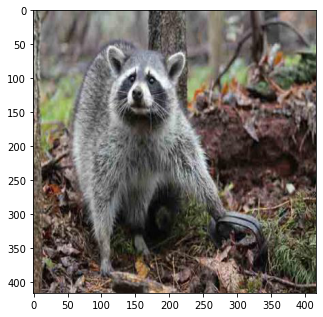

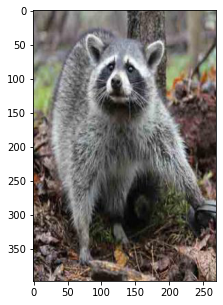

saved as face/train/cropped/raccoon-121_jpg.rf.f6ebf9b6da4eaafdb71331856fed141e_cropped_0.jpg


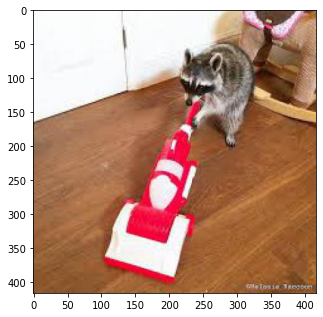

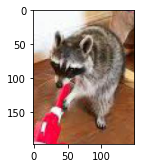

saved as face/train/cropped/raccoon-171_jpg.rf.e00ec73c6a64a07c1bc0035fa0fbca18_cropped_0.jpg


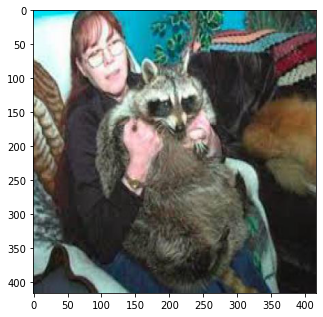

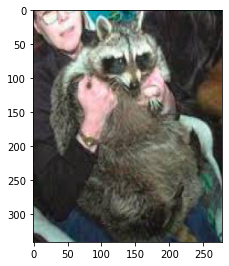

saved as face/train/cropped/raccoon-136_jpg.rf.47c7f0f51edf22d75682fe3c49dd074a_cropped_0.jpg


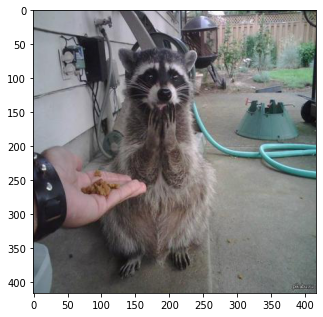

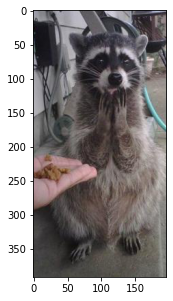

saved as face/train/cropped/raccoon-108_jpg.rf.b1c0928dfe114cfbd882e12141203f21_cropped_0.jpg


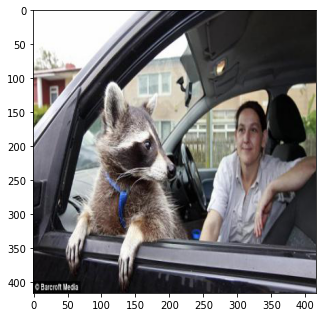

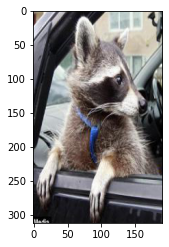

saved as face/train/cropped/raccoon-175_jpg.rf.5c172ad47029edf77be38f333f49c6cd_cropped_0.jpg


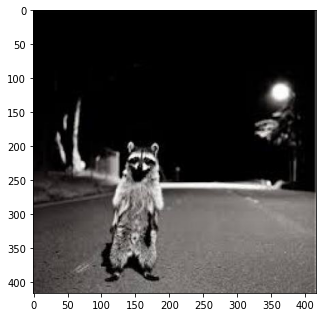

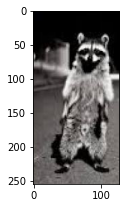

saved as face/train/cropped/raccoon-151_jpg.rf.63bf95faedb0eb9e67960f1c0c43f60a_cropped_0.jpg


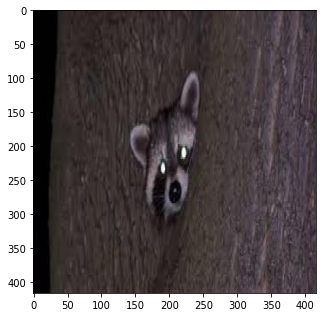

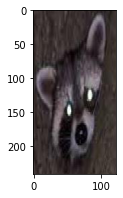

saved as face/train/cropped/raccoon-166_jpg.rf.c9c73f9a211869c92d3412c60cceac81_cropped_0.jpg


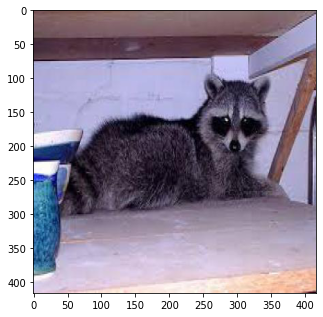

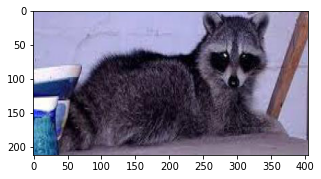

saved as face/train/cropped/raccoon-124_jpg.rf.ddf799871eb7bc5ceca93b4de5665b19_cropped_0.jpg


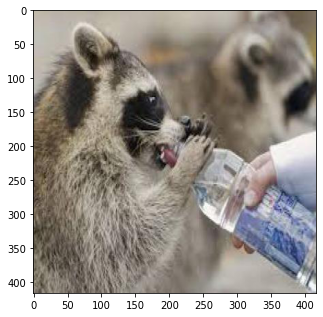

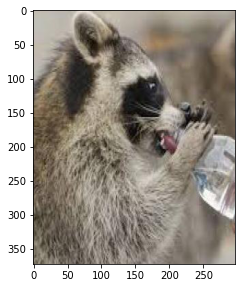

saved as face/train/cropped/raccoon-167_jpg.rf.f10d27f483841a478c526980439c79d8_cropped_0.jpg


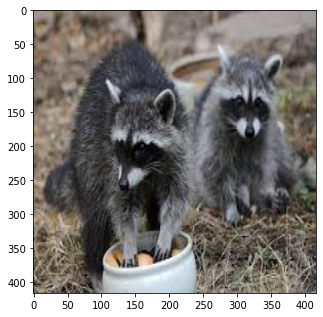

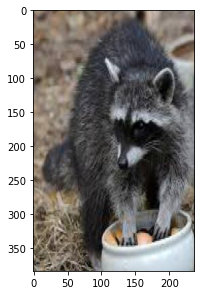

saved as face/train/cropped/raccoon-177_jpg.rf.1ffe2bcc19c2311f8c8d4ace8932a88d_cropped_0.jpg


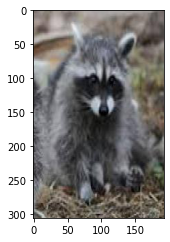

saved as face/train/cropped/raccoon-177_jpg.rf.1ffe2bcc19c2311f8c8d4ace8932a88d_cropped_1.jpg


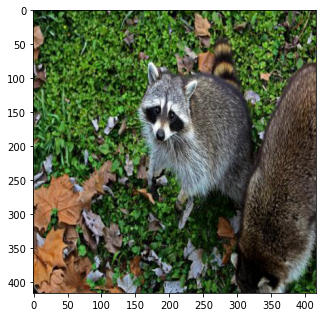

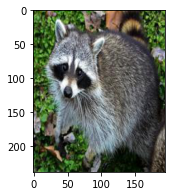

saved as face/train/cropped/raccoon-130_jpg.rf.25161fc808fcd8453a86271fe596919a_cropped_0.jpg


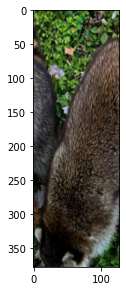

saved as face/train/cropped/raccoon-130_jpg.rf.25161fc808fcd8453a86271fe596919a_cropped_1.jpg


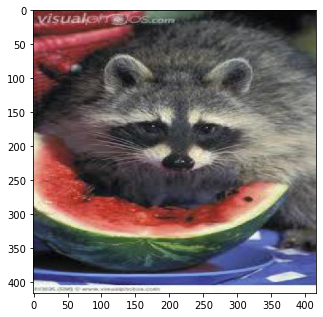

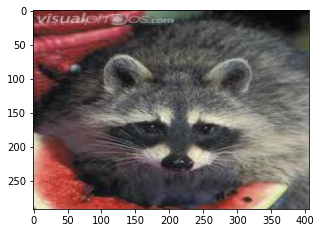

saved as face/train/cropped/raccoon-122_jpg.rf.15cffc72b474e63027182cd847834316_cropped_0.jpg


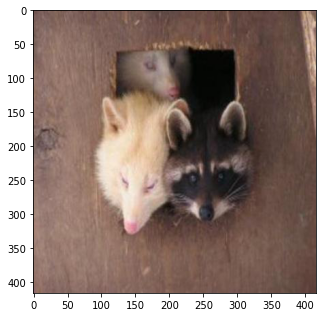

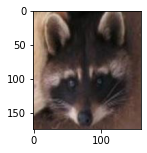

saved as face/train/cropped/raccoon-187_jpg.rf.d8fc7a310b84d7776c66507634446811_cropped_0.jpg


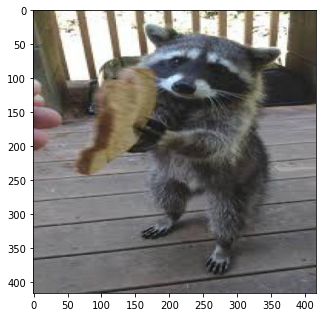

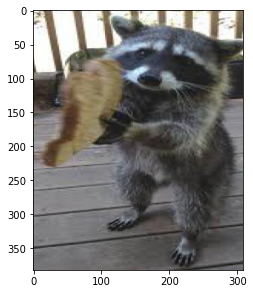

saved as face/train/cropped/raccoon-110_jpg.rf.eebb2a613d561ef001c0f3b35710c779_cropped_0.jpg


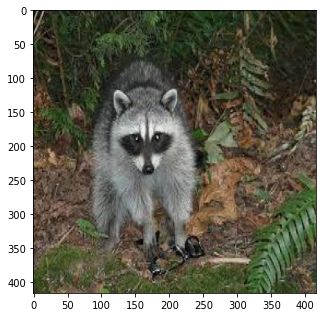

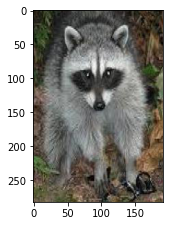

saved as face/train/cropped/raccoon-162_jpg.rf.d2840607abbe025e9e81d523133f137d_cropped_0.jpg


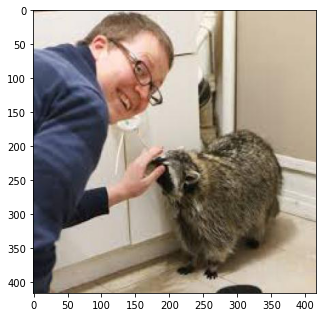

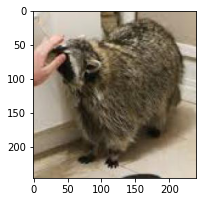

saved as face/train/cropped/raccoon-196_jpg.rf.a6da7cedce59b51c62f6ab91cf3c953b_cropped_0.jpg


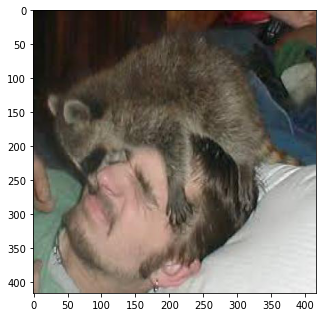

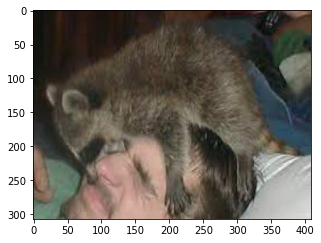

saved as face/train/cropped/raccoon-163_jpg.rf.f2a2ca26f88d90a5d82142c377f40154_cropped_0.jpg


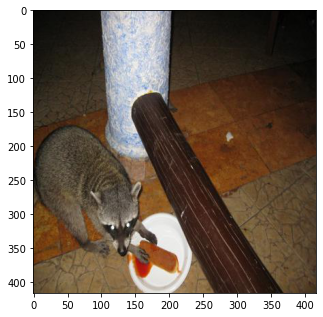

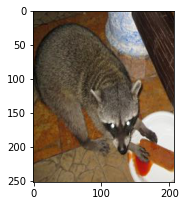

saved as face/train/cropped/raccoon-179_jpg.rf.0994f94900ca15a0c638076e40122ff4_cropped_0.jpg


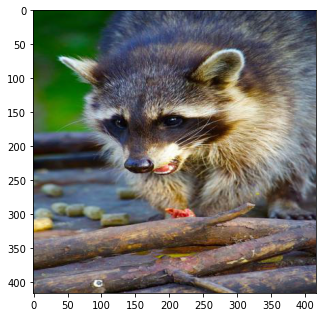

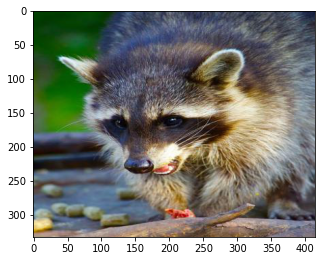

saved as face/train/cropped/raccoon-147_jpg.rf.548e3735d38bfacd279dad5e8d9578a1_cropped_0.jpg


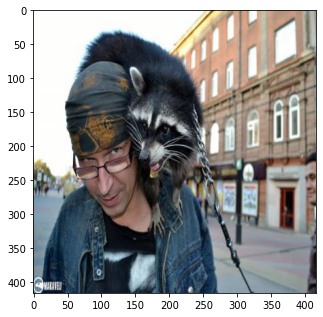

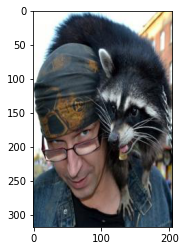

saved as face/train/cropped/raccoon-174_jpg.rf.05815e0d7dc378ed8188d368ccc857ce_cropped_0.jpg


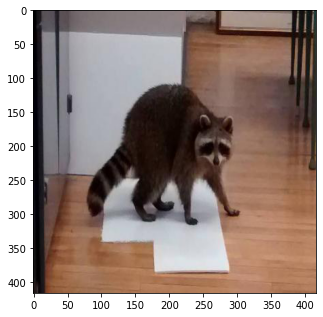

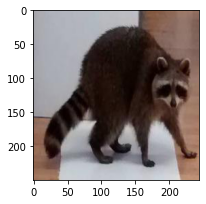

saved as face/train/cropped/raccoon-32_jpg.rf.b41a8efc0d66b3b2810bc90e15385817_cropped_0.jpg


In [46]:
import matplotlib.pyplot as plt
import numpy as np
import cv2

def show_image(image):

    DPI = 80.
    height, width, depth = image.shape
    fig = plt.figure(figsize=(width/DPI, height/DPI))
    plt.imshow(image)
    plt.show()

def get_detection_cropped(model, image):

    bboxes = model.predict(image)

    cropped = []
    for box in bboxes:
        x1, y1, x2, y2 = box[:4].astype(np.int)
        confidence = box[4]
        class_id = int(box[5])
        cropped.append(image[y1:y2,x1:x2,:])

    return cropped, bboxes

def save_cropped(path, file_name, i, cropped):

    new_name = path+"/"+ file_name.split("/")[-1].replace(".jpg", "_cropped_{}.jpg".format(i))
    plt.imsave(new_name, cropped)
    print("saved as {}".format(new_name))

for file_name in file_list:

    image = plt.imread(file_name)
    show_image(image)

    croppeds, _ = get_detection_cropped(detection_model, image)

    for i, cropped in enumerate(croppeds):
        show_image(cropped)
        save_cropped(CROPPED_PATH, file_name, i, cropped)


In [48]:
!ls -al {CROPPED_PATH}

print()
print(CROPPED_PATH)

total 3048
drwxr-xr-x 2 root root 20480 Jan 13 00:11 .
drwxr-xr-x 3 root root 32768 Jan 13 00:09 ..
-rw-r--r-- 1 root root 12086 Jan 13 00:10 raccoon-100_jpg.rf.e9338202a924dc489ffd94e0291a0f39_cropped_0.jpg
-rw-r--r-- 1 root root 13896 Jan 13 00:10 raccoon-101_jpg.rf.a9e8a95f51d60d7d3b40d3243aa11afd_cropped_0.jpg
-rw-r--r-- 1 root root 14254 Jan 13 00:10 raccoon-102_jpg.rf.d140a1fcbfc8d62c7ad37167714f79df_cropped_0.jpg
-rw-r--r-- 1 root root 28640 Jan 13 00:11 raccoon-103_jpg.rf.7148e5c7d785760fe9cb6b7762180977_cropped_0.jpg
-rw-r--r-- 1 root root  5123 Jan 13 00:10 raccoon-104_jpg.rf.e5f8de5f977a32d8a7f2223574ff2b72_cropped_0.jpg
-rw-r--r-- 1 root root 12349 Jan 13 00:10 raccoon-105_jpg.rf.73bb0ca933f4a5d8e47ee57c46617cd7_cropped_0.jpg
-rw-r--r-- 1 root root 13543 Jan 13 00:10 raccoon-106_jpg.rf.10f11a11172797e1e1a0ab2db39f7f0f_cropped_0.jpg
-rw-r--r-- 1 root root 17115 Jan 13 00:10 raccoon-107_jpg.rf.fcfeeca4a65ce335eaaf55935489ff4e_cropped_0.jpg
-rw-r--r-- 1 root root 14503 Jan 13 

# 얼굴 인식

## 모델 로딩

In [49]:
from tensorflow import keras
classificaiton_model = keras.models.load_model(GDRIVE_PATH+"/"+FACE_CLASSIFICATION_MODEL_FILE)

In [50]:
def classify(model, images):
    def resize(image):
        return cv2.resize(image, (224, 224))
    resizeds = np.array([ resize(image) for image in images ])
    y_ = model.predict(resizeds)
    class_ids = np.argmax(y_, axis=-1)
    confidences = np.max(y_, axis=-1)
    return class_ids, confidences

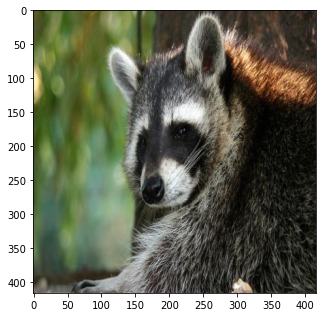

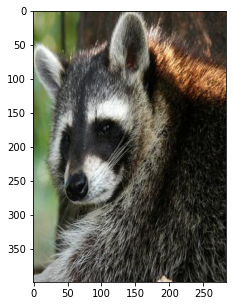

[0] [0.999944]


In [51]:
target_file_name = "face/test/raccoon-57_jpg.rf.26f3fae218f26088f6a7405c58ae8020.jpg"

image = plt.imread(target_file_name)
show_image(image)

croppeds, bboxes = get_detection_cropped(detection_model, image)
for cropped in croppeds:
    show_image(cropped)

class_ids, confidences = classify(classificaiton_model, croppeds)
print(class_ids, confidences)


